In [4]:
import os
import shutil
import random
from pathlib import Path
import h5py
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
from utils import data_loader_utils
import matplotlib.pyplot as plt
'''from tsfresh import extract_features
from tsfresh import select_features
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
from sklearn.metrics import f1_score, roc_auc_score
from tsfresh import select_features, extract_features
from tsfresh.utilities.dataframe_functions import impute
from tsfresh.feature_extraction.feature_calculators import (skewness, kurtosis, minimum, maximum, standard_deviation, approximate_entropy)
from tsfresh.feature_extraction import MinimalFCParameters'''
import shutil
from scipy.signal import spectrogram


In [5]:
def load_data(file_path):
    """
    Load vibration data from an HDF5 file.
    """
    with h5py.File(file_path, 'r') as file:
        df = file['vibration_data'][:]
    return pd.DataFrame({'X': df[:, 0], 'Y': df[:, 1], 'Z': df[:, 2]})

In [6]:
def find_all_h5s_in_dir(s_dir):
    """
    list all .h5 files in a directory
    """

    fileslist = []
    for root, dirs, files in os.walk(s_dir):
        for file in files:
            if file.endswith(".h5"):
                fileslist.append(file)
    return fileslist

In [7]:
# Define a function to load H5 files and calculate the duration in seconds
def load_h5_files_and_calculate_duration(data_root):
    data_list = []
    labels = []

    for machine in ['M01', 'M02', 'M03']:
        for operation in os.listdir(os.path.join(data_root, machine)):
            if os.path.isdir(os.path.join(data_root, machine, operation)):
                for label in ['good', 'bad']:
                    data_path = os.path.join(data_root, machine, operation, label)
                    files = find_all_h5s_in_dir(data_path)

                    for file in files:
                        file_path = os.path.join(data_path, file)
                        with h5py.File(file_path, 'r') as f:
                            vibration_data = f['vibration_data'][:]
                            samples_s = len(vibration_data) / 2000  # Assuming a data sampling frequency of 2000 Hz

                        data_list.append({
                            'Machine': machine,
                            'Operation': operation,
                            'Sample Type': label,
                            'File Name': file,
                            'Duration (s)': samples_s
                        })

    return data_list

In [8]:
def datafile_read(files, dataset_labels=None, plotting=True):
    """Loads and plots data from multiple datafiles in separate subplots for each axis with dataset labels.

    Keyword Arguments:
        files {list} -- List of file paths
        dataset_labels {list} -- List of dataset labels for legends (optional)

    Returns:
        list of ndarrays -- List of raw data arrays
    """
    all_data = []
    max_samples = 0

    for file in files:
        with h5py.File(file, 'r') as f:
            vibration_data = f['vibration_data'][:]
        all_data.append(vibration_data)
        max_samples = max(max_samples, len(vibration_data))

    # Interpolation for the x-axis plot
    freq = 2000
    samples_s = max_samples / freq
    samples = np.linspace(0, samples_s, max_samples)

    if plotting:
        fig, axs = plt.subplots(3, 1, figsize=(12, 9), sharex=True)

        for i, data in enumerate(all_data):
            if len(data) < max_samples:
                padding = np.full((max_samples - len(data), 3), np.nan)
                data = np.vstack((data, padding))

            # Determine label based on file name
            file_path = files[i].lower()
            if 'good' in file_path:
                label = 'Good'
                color = 'blue'
                linestyle = '-'
                alpha = 0.7
            elif 'bad' in file_path:
                label = 'Bad'
                color = 'red'
                linestyle = '--'
                alpha = 0.7
            else:
                label = f'Dataset {i + 1}'
                color = 'gray'
                linestyle = '-.'
                alpha = 0.5

            axs[0].plot(samples, data[:, 0], label=f'X-axis - {label}', color=color,
                        alpha=alpha, linewidth=1.5, linestyle=linestyle)
            axs[1].plot(samples, data[:, 1], label=f'Y-axis - {label}', color=color,
                        alpha=alpha, linewidth=1.5, linestyle=linestyle)
            axs[2].plot(samples, data[:, 2], label=f'Z-axis - {label}', color=color,
                        alpha=alpha, linewidth=1.5, linestyle=linestyle)

        axs[0].set_ylabel('X-axis Vibration Data')
        axs[1].set_ylabel('Y-axis Vibration Data')
        axs[2].set_ylabel('Z-axis Vibration Data')
        axs[2].set_xlabel('Time [sec]')

        for ax in axs:
            ax.locator_params(axis='y', nbins=10)
            ax.grid()
            ax.legend()

        plt.show()

    return all_data


In [9]:
machines = ["M01","M02","M03"]
process_names = ["OP00","OP01","OP02","OP03","OP04","OP05","OP06","OP07","OP08","OP09","OP10","OP11","OP12","OP13","OP14"]
labels = ["good","bad"]
path_to_dataset = "../data/final/whole"

In [10]:
X_data = []
y_data = []
for process_name in process_names:
    for machine in machines:
        for label in labels:
            data_path = os.path.join(path_to_dataset, machine, process_name, label)
            data_list, data_label = data_loader_utils.load_tool_research_data(data_path, add_additional_label=False, label=label)
            #concatenating
            X_data.extend(data_list)
            y_data.extend(data_label)

laoding files from ../data/final/whole\M01\OP00\good... 
laoding files from ../data/final/whole\M01\OP00\bad... 
laoding files from ../data/final/whole\M02\OP00\good... 
laoding files from ../data/final/whole\M02\OP00\bad... 
laoding files from ../data/final/whole\M03\OP00\good... 
laoding files from ../data/final/whole\M03\OP00\bad... 
laoding files from ../data/final/whole\M01\OP01\good... 
laoding files from ../data/final/whole\M01\OP01\bad... 
laoding files from ../data/final/whole\M02\OP01\good... 
laoding files from ../data/final/whole\M02\OP01\bad... 
laoding files from ../data/final/whole\M03\OP01\good... 
laoding files from ../data/final/whole\M03\OP01\bad... 
laoding files from ../data/final/whole\M01\OP02\good... 
laoding files from ../data/final/whole\M01\OP02\bad... 
laoding files from ../data/final/whole\M02\OP02\good... 
laoding files from ../data/final/whole\M02\OP02\bad... 
laoding files from ../data/final/whole\M03\OP02\good... 
laoding files from ../data/final/whole\

In [11]:
good_X_data = []
good_y_data = []
bad_X_data = []
bad_y_data = []

for i, label in enumerate(y_data):
    if label == "good":
        good_X_data.append(X_data[i])
        good_y_data.append(label)
    elif label == "bad":
        bad_X_data.append(X_data[i])
        bad_y_data.append(label)
    else:
        # Handle other labels if necessary
        pass


In [12]:
len(bad_y_data)

70

In [8]:

# Load the HDF5 file
data_file = '../../cnc_data/Whole/M02/OP01/good/M02_Aug_2019_OP01_002.h5'  # Replace with the actual file path

with h5py.File(data_file, 'r') as file:
    # Extract the vibration data
    vibration_data = file['vibration_data'][:]

# Create a Pandas DataFrame with separate columns for X, Y, and Z
vibration_df = pd.DataFrame({'X': vibration_data[:, 0], 'Y': vibration_data[:, 1], 'Z': vibration_data[:, 2]})
time = len(vibration_df)/2000
# Display the first few rows of the DataFrame
print(vibration_df, time)

           X     Y       Z
0       17.0  -3.0 -1024.0
1       15.0  23.0 -1040.0
2        7.0  11.0 -1024.0
3       15.0   0.0 -1038.0
4        5.0  37.0 -1032.0
...      ...   ...     ...
57339   29.0  21.0 -1028.0
57340  144.0   1.0 -1069.0
57341   21.0 -52.0 -1089.0
57342  -81.0   9.0 -1044.0
57343  132.0   3.0 -1001.0

[57344 rows x 3 columns] 28.672


In [9]:
plt.style.use('default')  # or 'classic' for old-school Matplotlib look


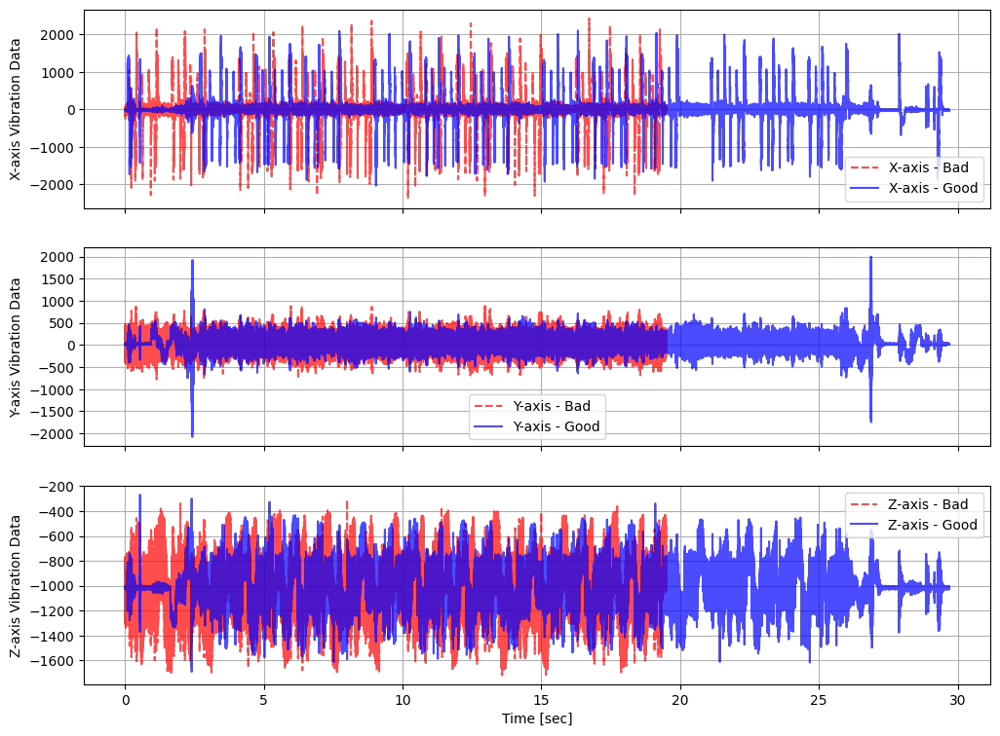

In [10]:
# Example usage:
files=['../data/final/whole/M01/OP01/bad/M01_Aug_2019_OP01_000.h5',
       '../data/final/whole/M01/OP01/good/M01_Aug_2019_OP01_001.h5']
dataset_labels = ["Bad Dataset", "Good Dataset"]  # Add labels for your datasets

data = datafile_read(files, dataset_labels)


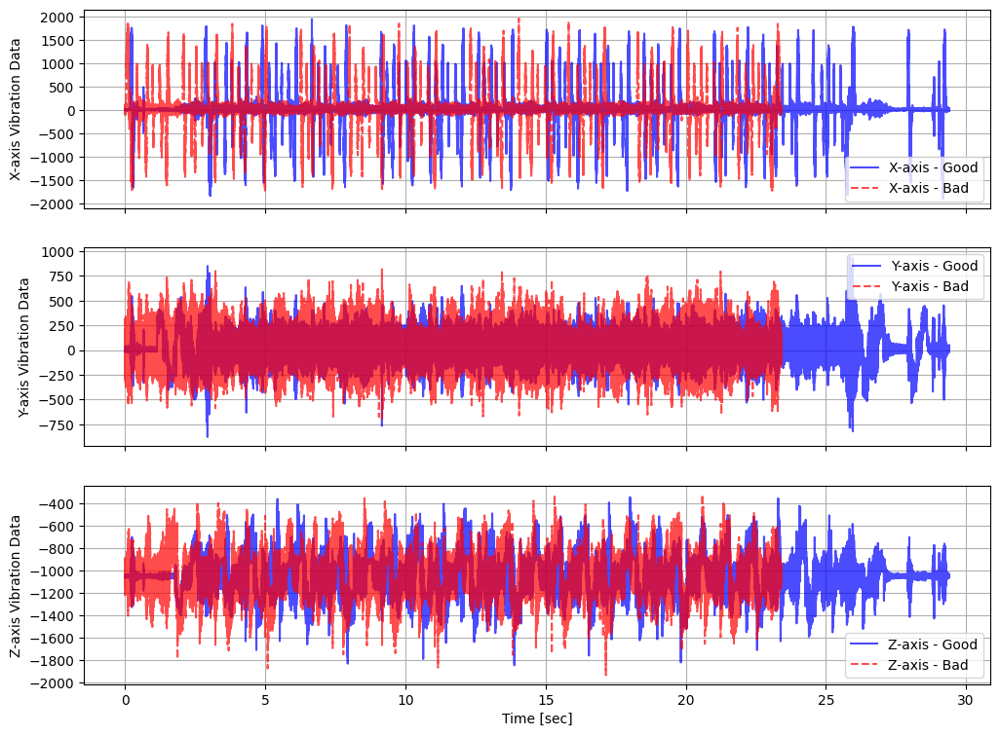

In [64]:
# Example usage:
files=['../data/final/whole/M02/OP01/good/M02_Feb_2019_OP01_000.h5',
       '../data/final/whole/M02/OP01/bad/M02_Feb_2019_OP01_000.h5']
dataset_labels = ["Bad Dataset", "Good Dataset"]  # Add labels for your datasets

data = datafile_read(files, dataset_labels)


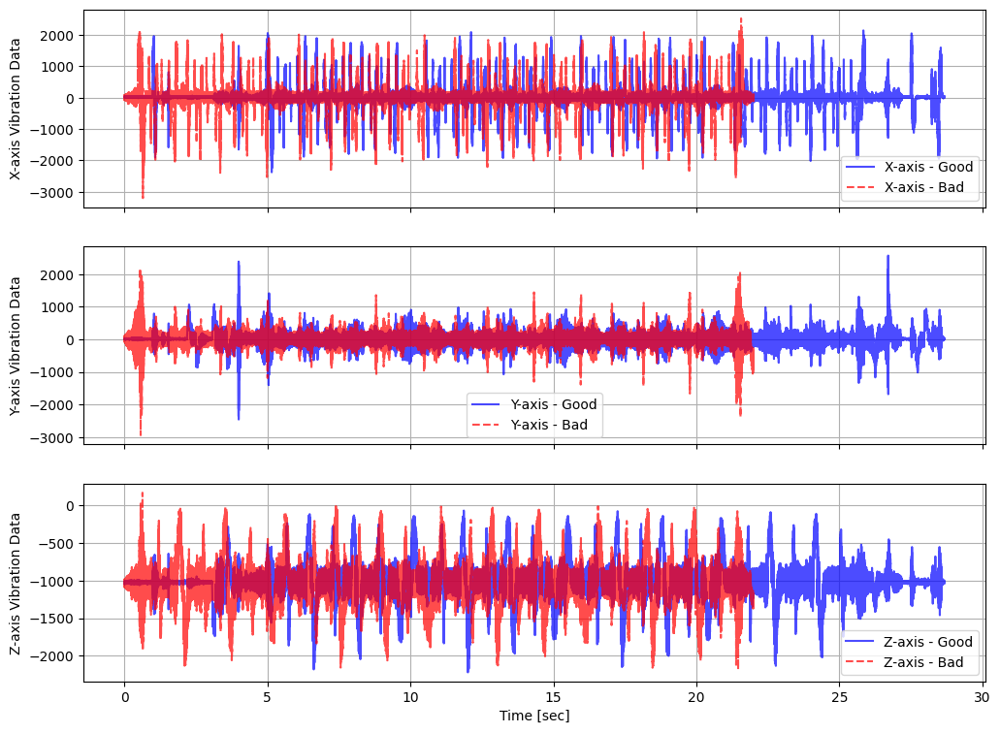

In [65]:
 #  # Example usage: M03 is excluded in final selection

files=['../data/final/whole/M03/OP01/good/M03_Feb_2021_OP01_000.h5',
       '../data/final/whole/M03/OP01/bad/M03_Feb_2021_OP01_000.h5']
dataset_labels = ["Bad Dataset", "Good Dataset"]  # Add labels for your datasets

data = datafile_read(files, dataset_labels)


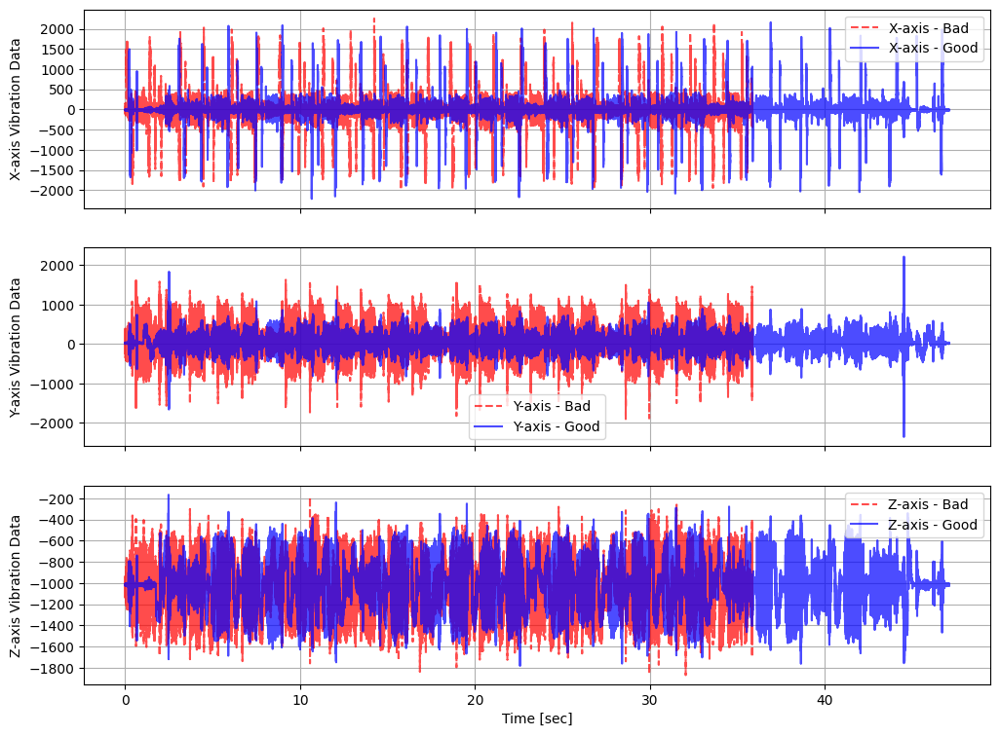

In [99]:
 # Example usage
files=['../data/final/whole/M01/OP02/bad/M01_Feb_2019_OP02_000.h5',
       '../data/final/whole/M01/OP02/good/M01_Aug_2019_OP02_007.h5']

data = datafile_read(files)

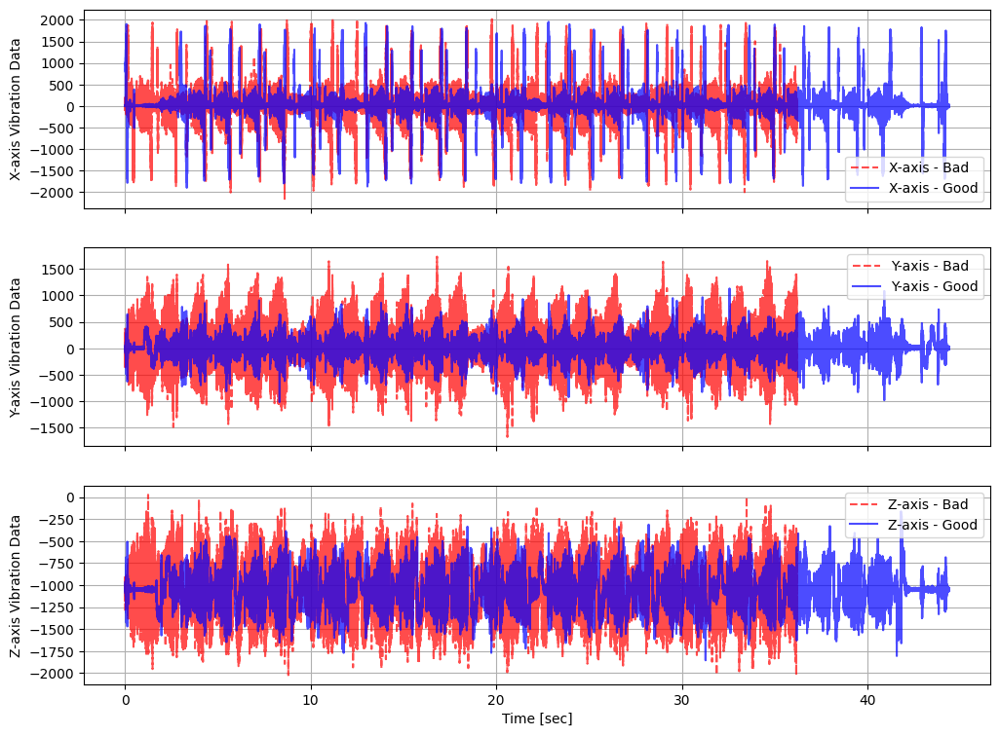

In [100]:
 # Example usage:
files=['../data/final/whole/M02/OP02/bad/M02_Feb_2019_OP02_000.h5',
       '../data/final/whole/M02/OP02/good/M02_Feb_2019_OP02_001.h5']

data = datafile_read(files)

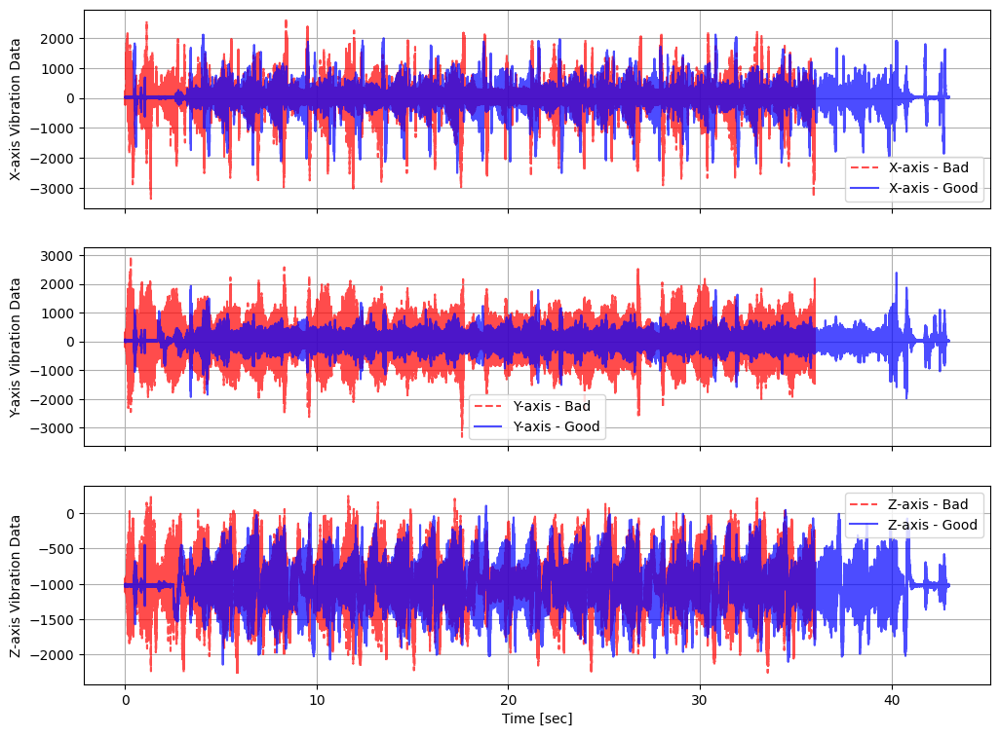

In [105]:
 # Example usage: machine 03 excluded
files=['../data/final/whole/M03/OP02/bad/M03_Feb_2021_OP02_000.h5',
       '../data/final/whole/M03/OP02/good/M03_Feb_2020_OP02_000.h5']

data = datafile_read(files)

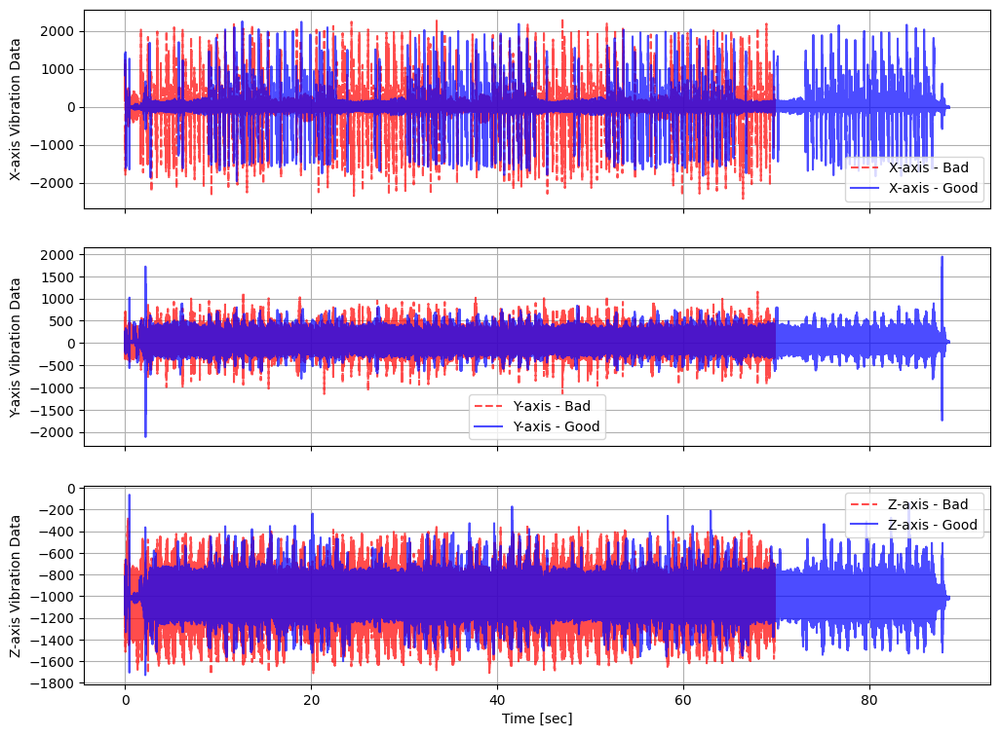

In [86]:
 # Example usage: operation 03, excluded in final selection
files=['../data/final/whole/M01/OP03/bad/M01_Aug_2019_OP03_000.h5',
       '../data/final/whole/M01/OP03/good/M01_Aug_2019_OP03_000.h5']

data = datafile_read(files)

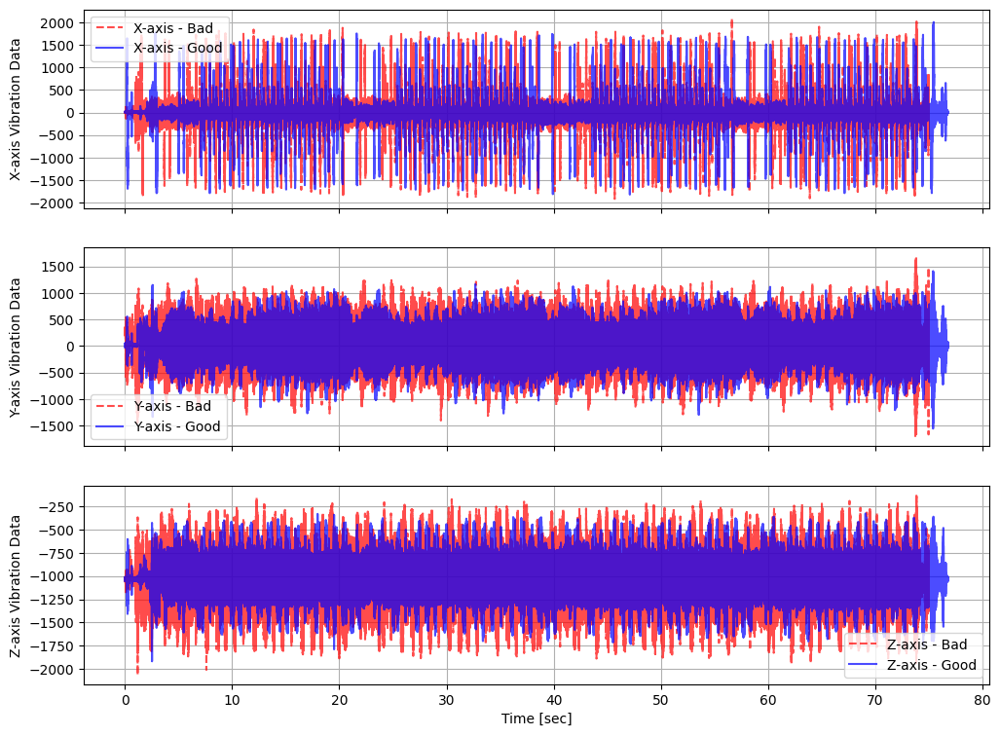

In [88]:
 # Example usage: operation 03, excluded in final selection
files=['../data/final/whole/M02/OP03/bad/M02_Feb_2021_OP03_000.h5',
       '../data/final/whole/M02/OP03/good/M02_Feb_2020_OP03_002.h5']

data = datafile_read(files)

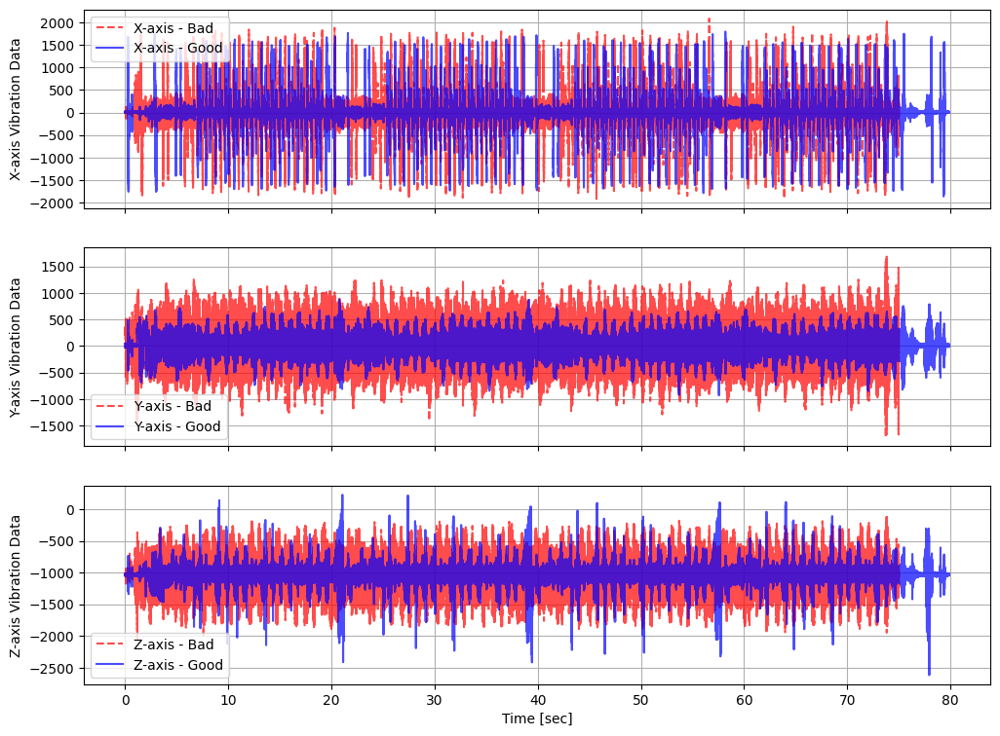

In [67]:
 #  # Example usage: operation 03, excluded in final selection

files=['../data/final/whole/M02/OP03/bad/M02_Feb_2021_OP03_000.h5',
       '../data/final/whole/M02/OP03/good/M02_Aug_2019_OP03_002.h5']

data = datafile_read(files)

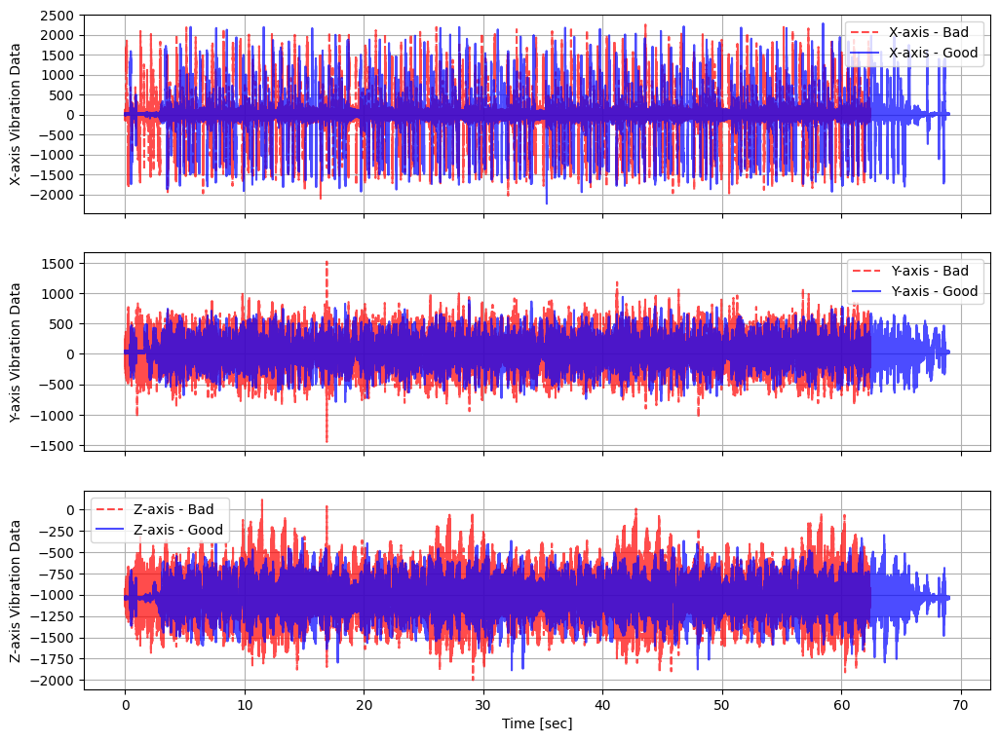

In [68]:
 # Example usage:
files=['../data/final/whole/M01/OP04/bad/M01_Feb_2019_OP04_000.h5',
       '../data/final/whole/M01/OP04/good/M01_Feb_2019_OP04_000.h5']
dataset_labels = ["Bad Dataset", "Good Dataset"]  # Add labels for your datasets

data = datafile_read(files, dataset_labels)


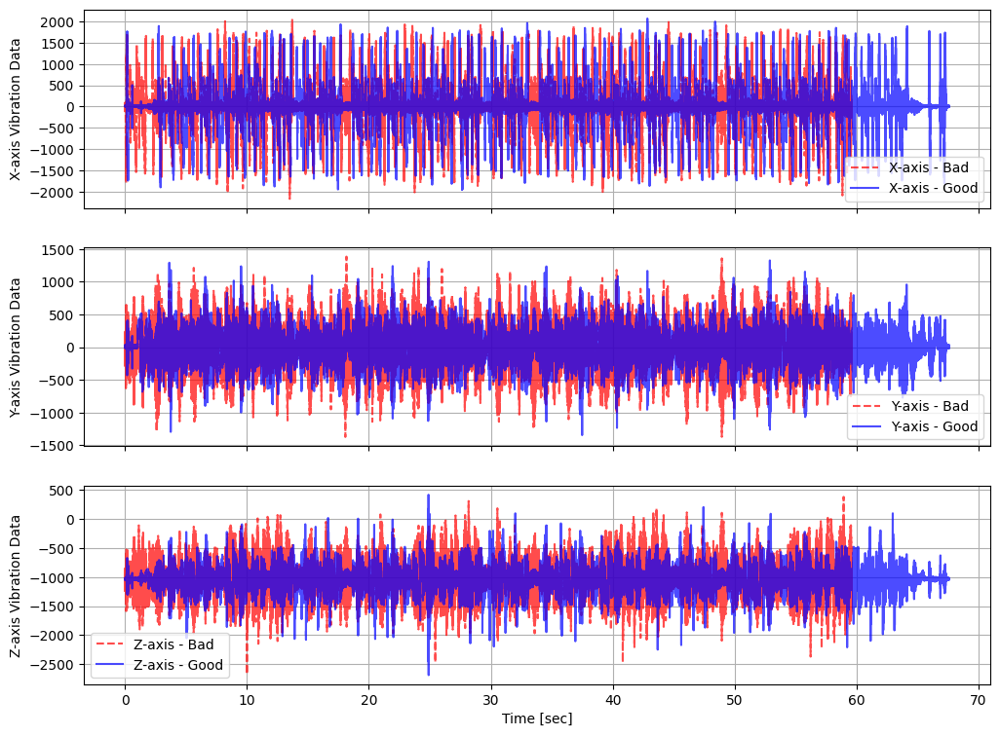

In [69]:
 # Example usage:
files=['../data/final/whole/M02/OP04/bad/M02_Aug_2019_OP04_000.h5',
       '../data/final/whole/M02/OP04/good/M02_Aug_2019_OP04_002.h5']
dataset_labels = ["Bad Dataset", "Good Dataset"]  # Add labels for your datasets

data = datafile_read(files, dataset_labels)


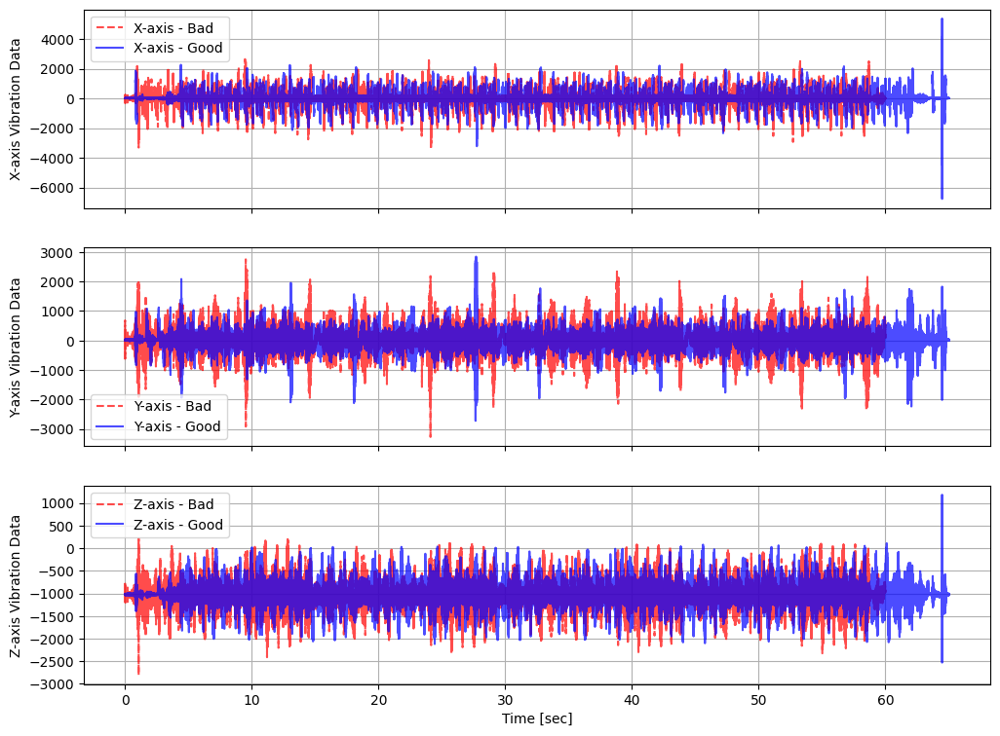

In [70]:
 # Example usage: M03 is excluded in final selection
files=['../data/final/whole/M03/OP04/bad/M03_Feb_2021_OP04_000.h5',
       '../data/final/whole/M03/OP04/good/M03_Aug_2019_OP04_001.h5']
dataset_labels = ["Bad Dataset", "Good Dataset"]  # Add labels for your datasets

data = datafile_read(files, dataset_labels)


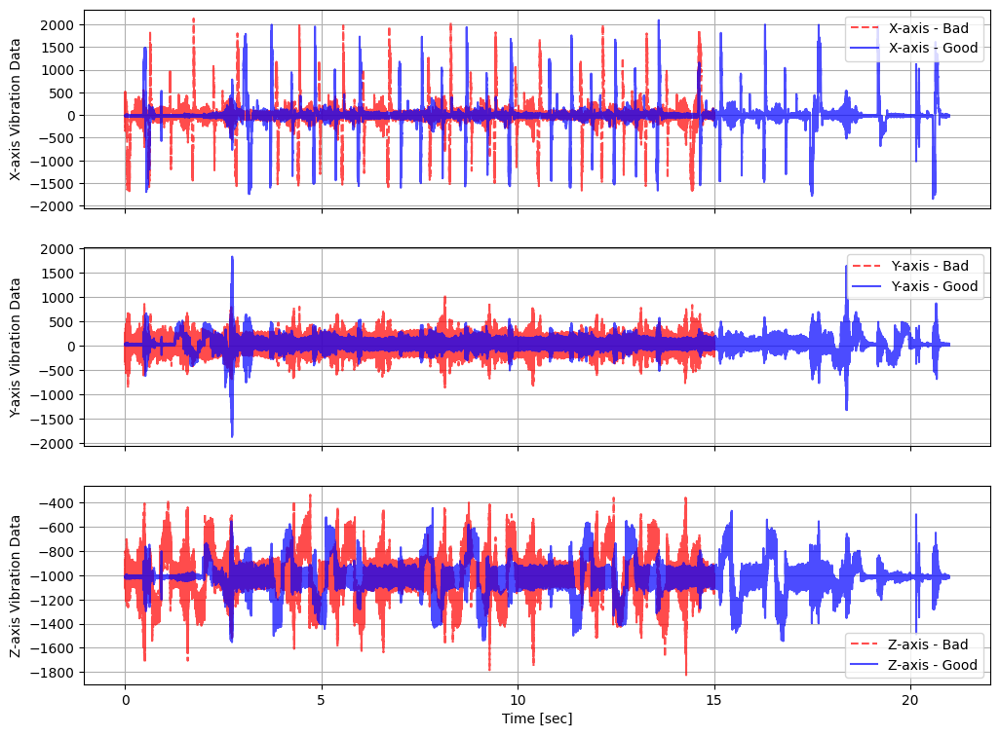

In [33]:
 # Example usage:
files=['../data/final/whole/M01/OP05/bad/M01_Feb_2021_OP05_000.h5',
       '../data/final/whole/M01/OP05/good/M01_Feb_2021_OP05_003.h5']

data = datafile_read(files, dataset_labels)


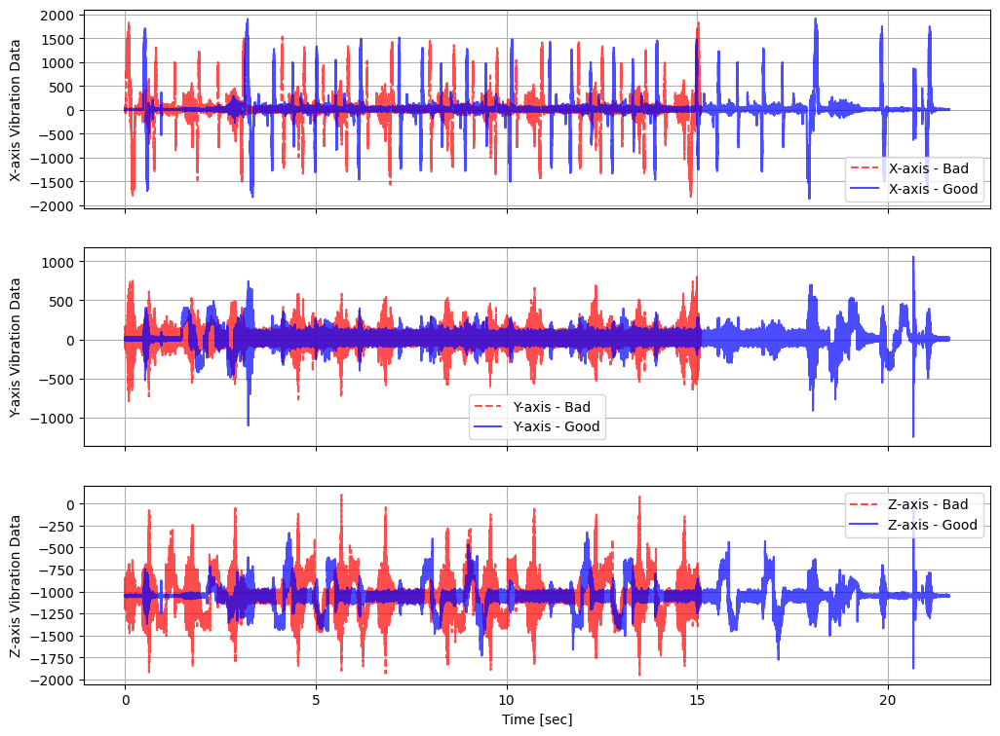

In [34]:
 # Example usage:
files=['../data/final/whole/M02/OP05/bad/M02_Feb_2019_OP05_000.h5',
       '../data/final/whole/M02/OP05/good/M02_Feb_2019_OP05_000.h5']

data = datafile_read(files)


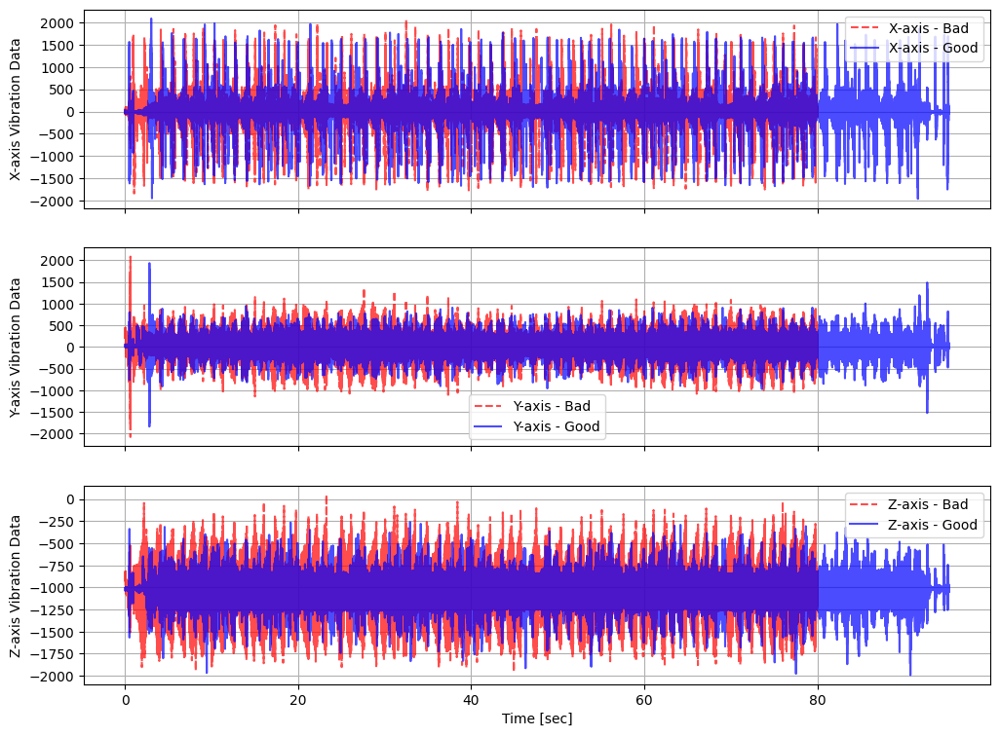

In [35]:
 # Example usage:
files=['../data/final/whole/M01/OP06/bad/M01_Aug_2021_OP06_001.h5',
       '../data/final/whole/M01/OP06/good/M01_Aug_2021_OP06_000.h5']

data = datafile_read(files, dataset_labels)


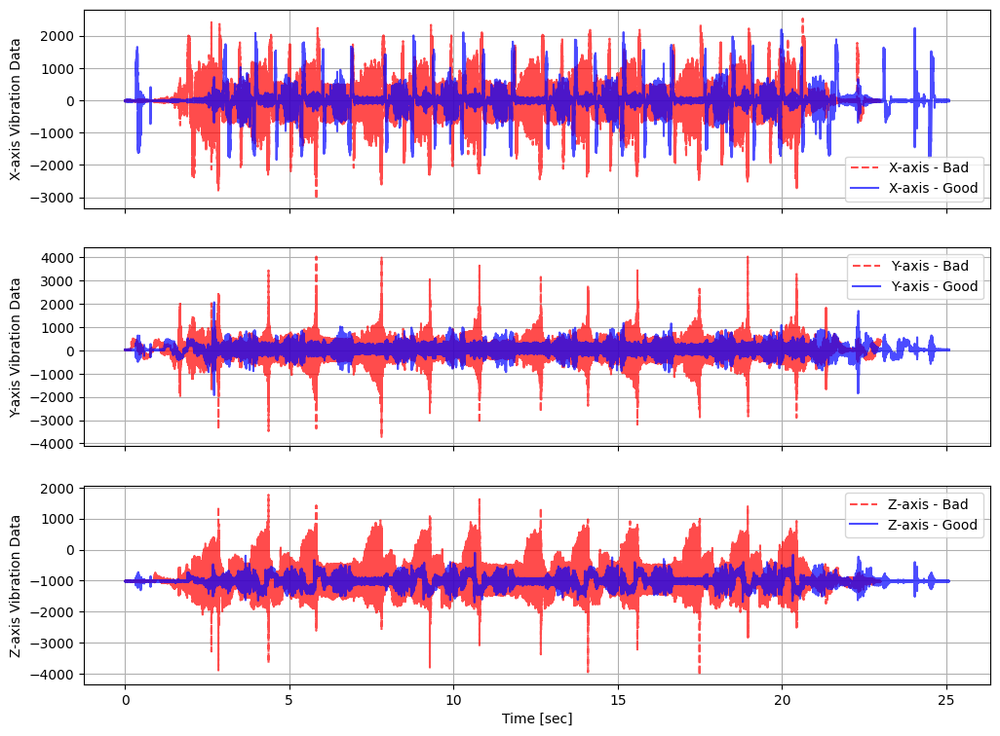

In [36]:
 # Example usage:
files=['../data/final/whole/M01/OP07/bad/M01_Aug_2021_OP07_001.h5',
       '../data/final/whole/M01/OP07/good/M01_Aug_2021_OP07_002.h5']

data = datafile_read(files, dataset_labels)


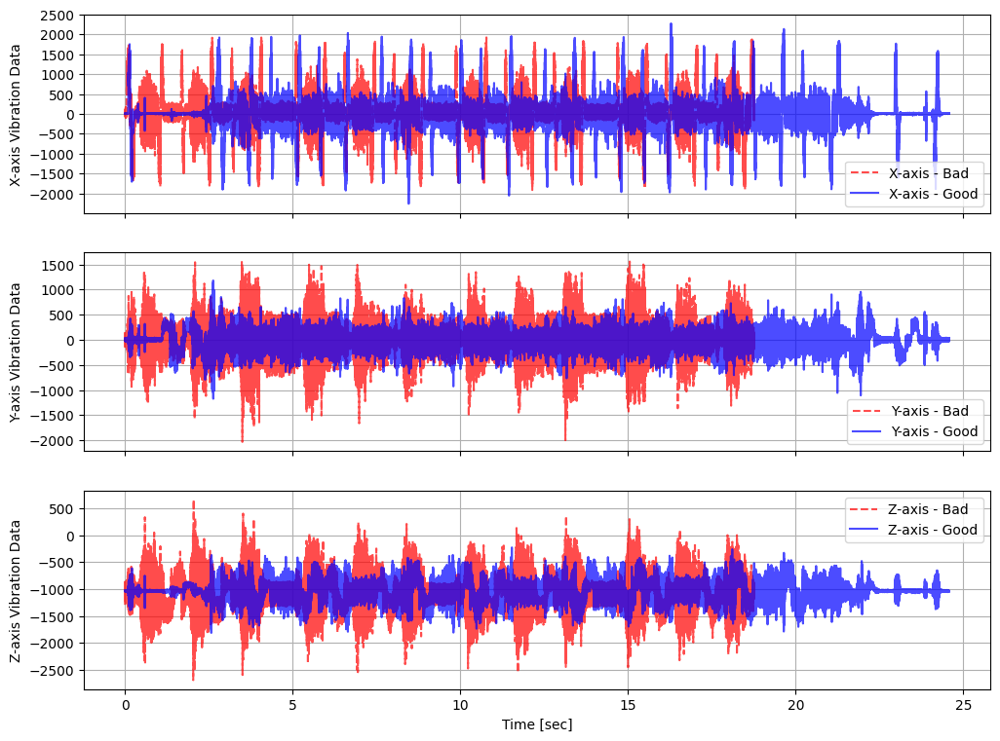

In [37]:
 # Example usage:
files=['../data/final/whole/M02/OP07/bad/M02_Feb_2019_OP07_000.h5',
       '../data/final/whole/M02/OP07/good/M02_Aug_2020_OP07_004.h5']

data = datafile_read(files, dataset_labels)


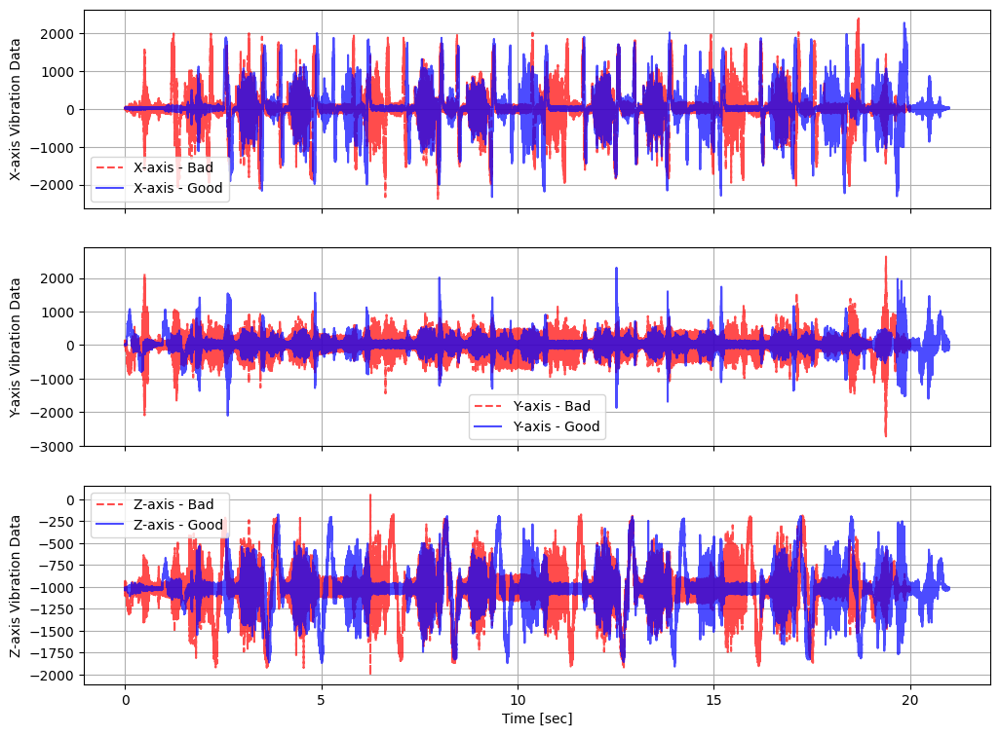

In [38]:
 # Example usage:
files=['../data/final/whole/M03/OP07/bad/M03_Aug_2021_OP07_000.h5',
       '../data/final/whole/M03/OP07/good/M03_Aug_2019_OP07_002.h5']

data = datafile_read(files, dataset_labels)


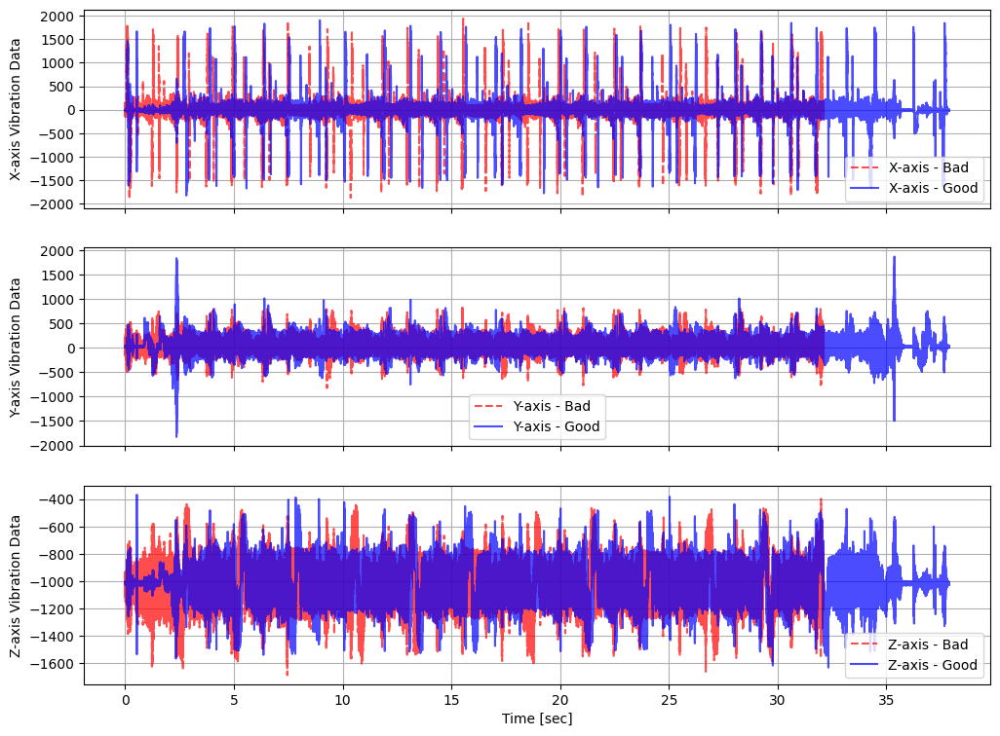

In [39]:
 # Example usage:
files=['../data/final/whole/M01/OP08/bad/M01_Feb_2019_OP08_000.h5',
       '../data/final/whole/M01/OP08/good/M01_Aug_2019_OP08_003.h5']

data = datafile_read(files, dataset_labels)


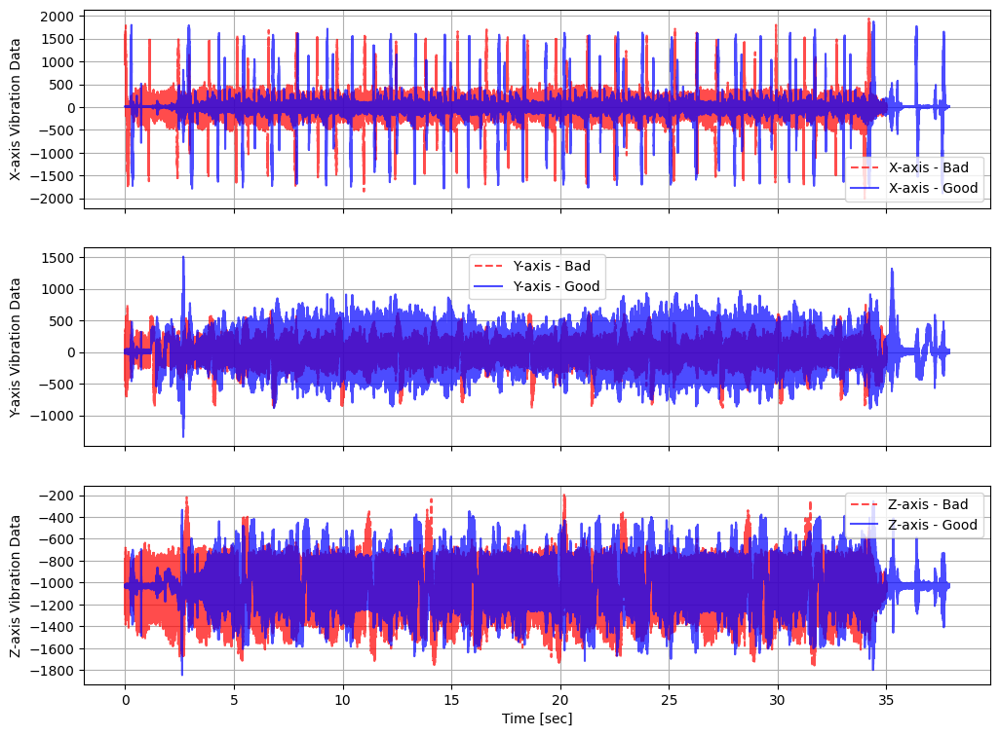

In [74]:
 # Example usage:
files=['../data/final/whole/M02/OP08/bad/M02_Aug_2021_OP08_000.h5',
       '../data/final/whole/M02/OP08/good/M02_Feb_2020_OP08_000.h5']

data = datafile_read(files, dataset_labels)


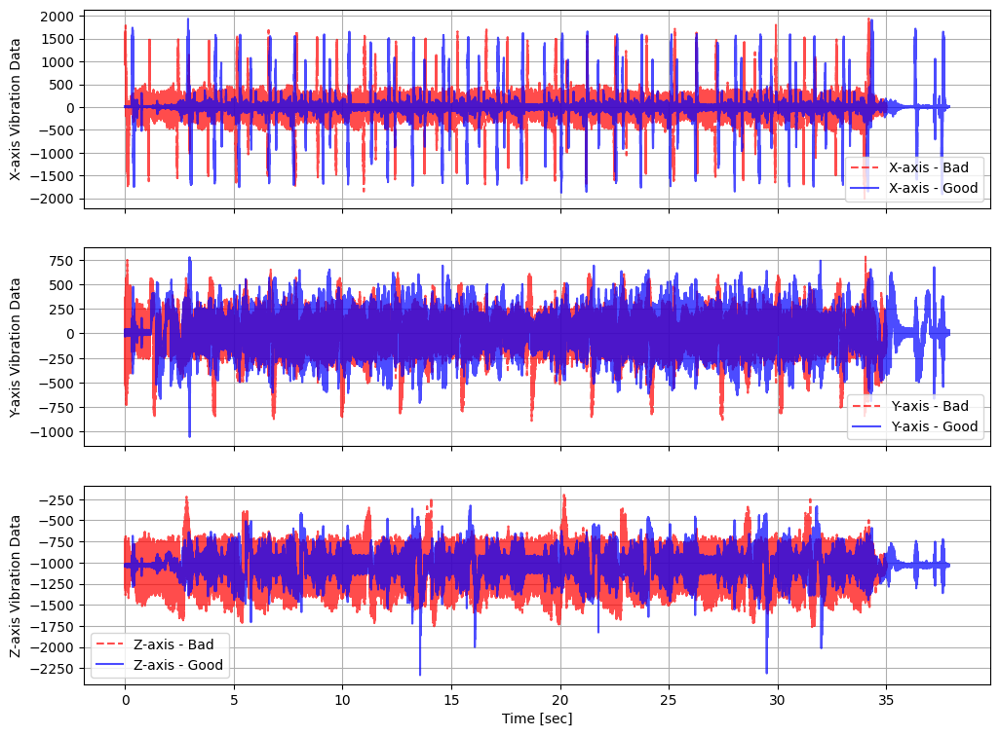

In [76]:
 # Example usage:
files=['../data/final/whole/M02/OP08/bad/M02_Aug_2021_OP08_000.h5',
       '../data/final/whole/M02/OP08/good/M02_Aug_2019_OP08_015.h5']

data = datafile_read(files, dataset_labels)


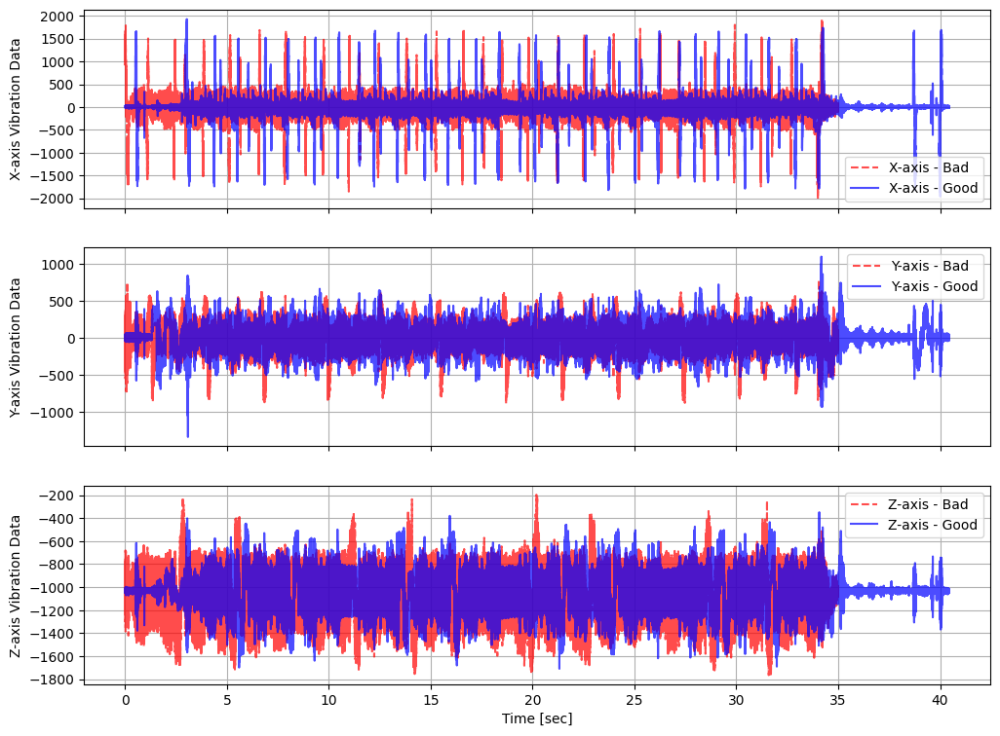

In [77]:
 # Example usage:
files=['../data/final/whole/M02/OP08/bad/M02_Aug_2021_OP08_000.h5',
       '../data/final/whole/M02/OP08/good/M02_Feb_2021_OP08_003.h5']

data = datafile_read(files, dataset_labels)


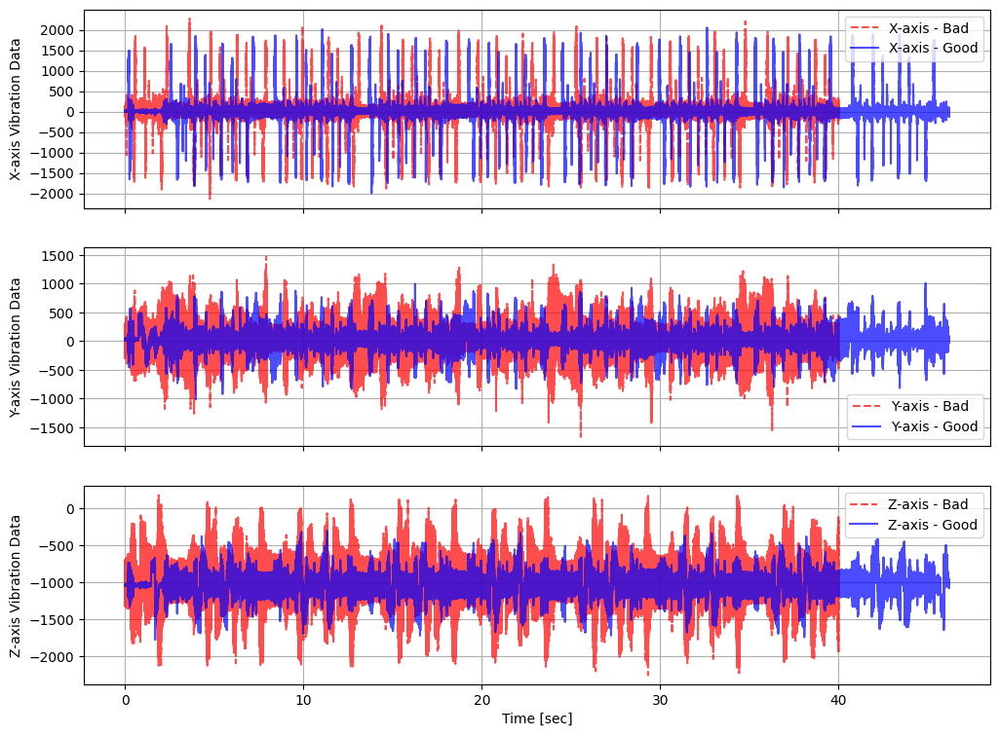

In [41]:
 # Example usage:
files=['../data/final/whole/M01/OP10/bad/M01_Aug_2021_OP10_000.h5',
       '../data/final/whole/M01/OP10/good/M01_Feb_2019_OP10_002.h5']

data = datafile_read(files, dataset_labels)


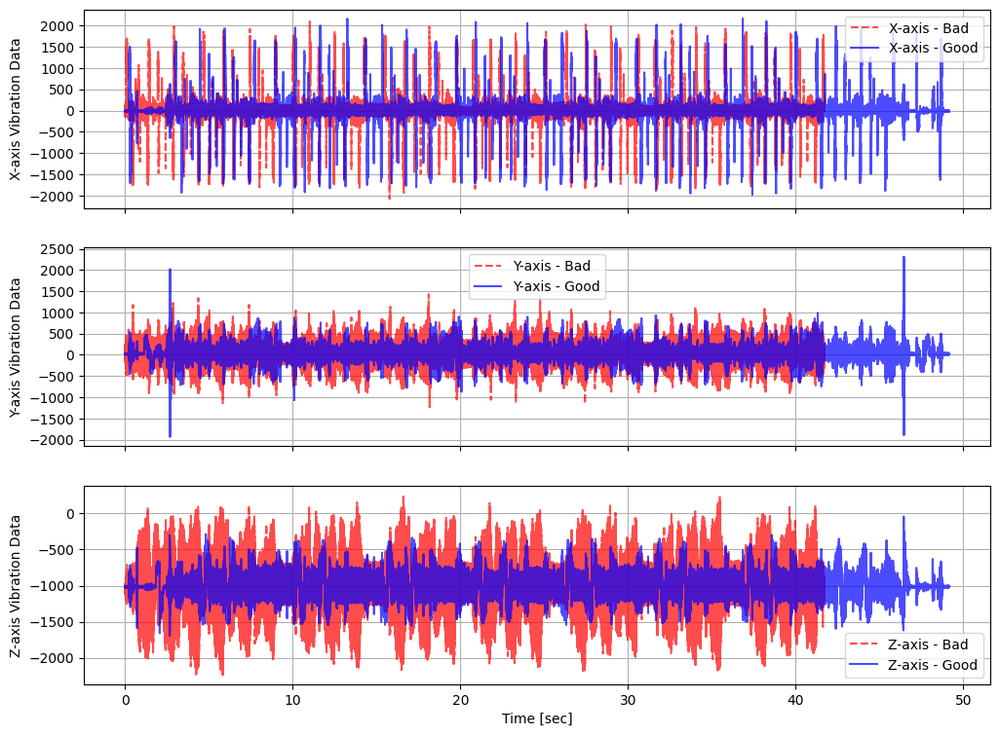

In [43]:
 # Example usage:
files=['../data/final/whole/M01/OP10/bad/M01_Feb_2019_OP10_000.h5',
       '../data/final/whole/M01/OP10/good/M01_Aug_2019_OP10_000.h5']

data = datafile_read(files)


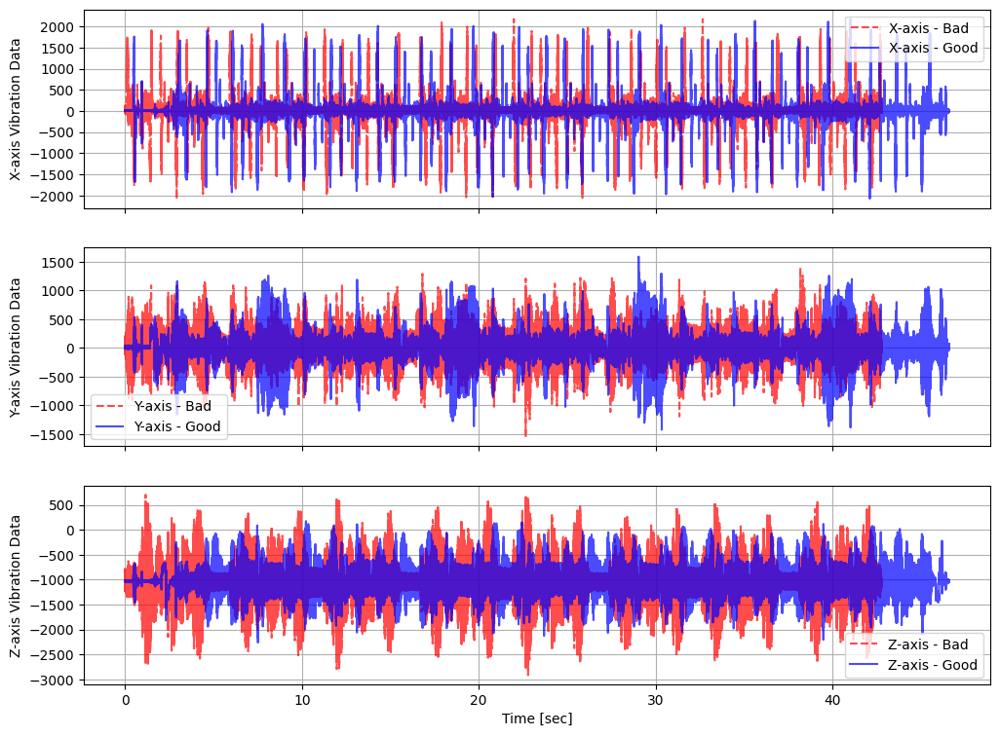

In [71]:
 # Example usage:
files=['../data/final/whole/M02/OP10/bad/M02_Feb_2019_OP10_000.h5',
       '../data/final/whole/M02/OP10/good/M02_Feb_2020_OP10_004.h5']

data = datafile_read(files, dataset_labels)


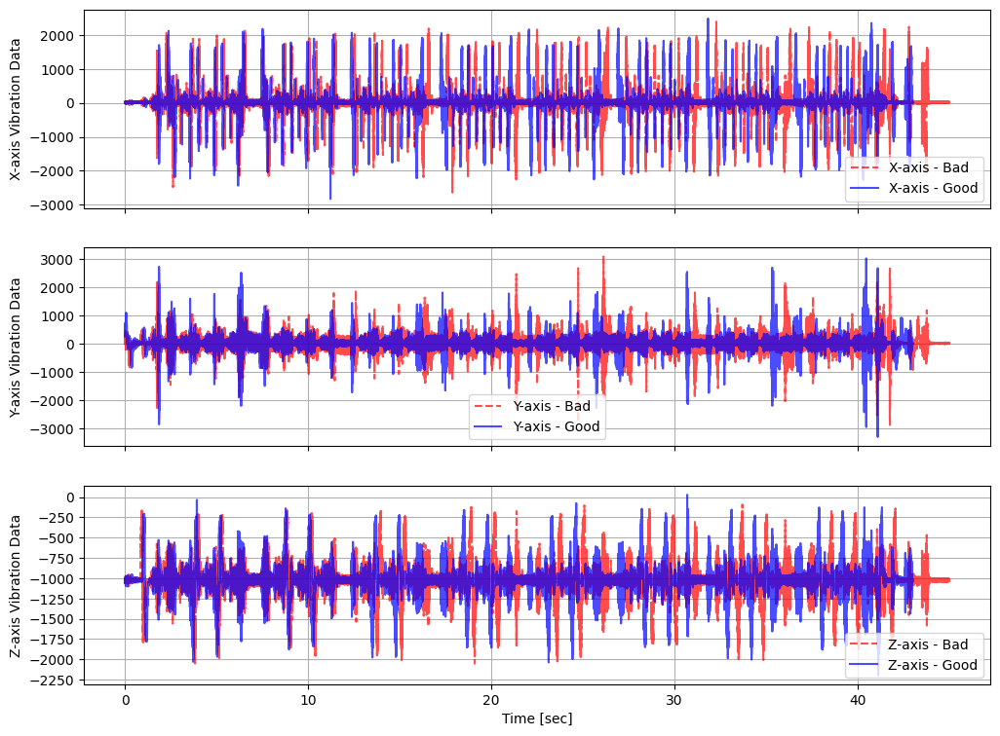

In [72]:
 # Example usage: M03 is excluded in final selection
files=['../data/final/whole/M03/OP10/bad/M03_Aug_2021_OP10_000.h5',
       '../data/final/whole/M03/OP10/good/M03_Aug_2021_OP10_000.h5']

data = datafile_read(files, dataset_labels)


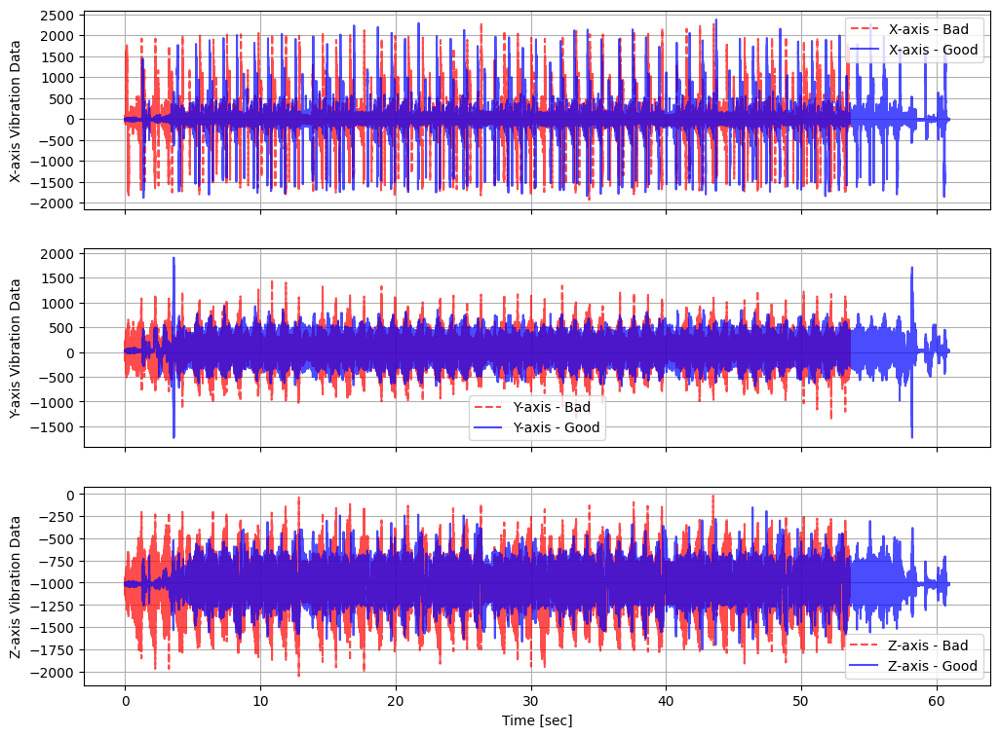

In [44]:
 # Example usage:
files=['../data/final/whole/M01/OP11/bad/M01_Feb_2019_OP11_002.h5',
       '../data/final/whole/M01/OP11/good/M01_Aug_2019_OP11_003.h5']

data = datafile_read(files, dataset_labels)


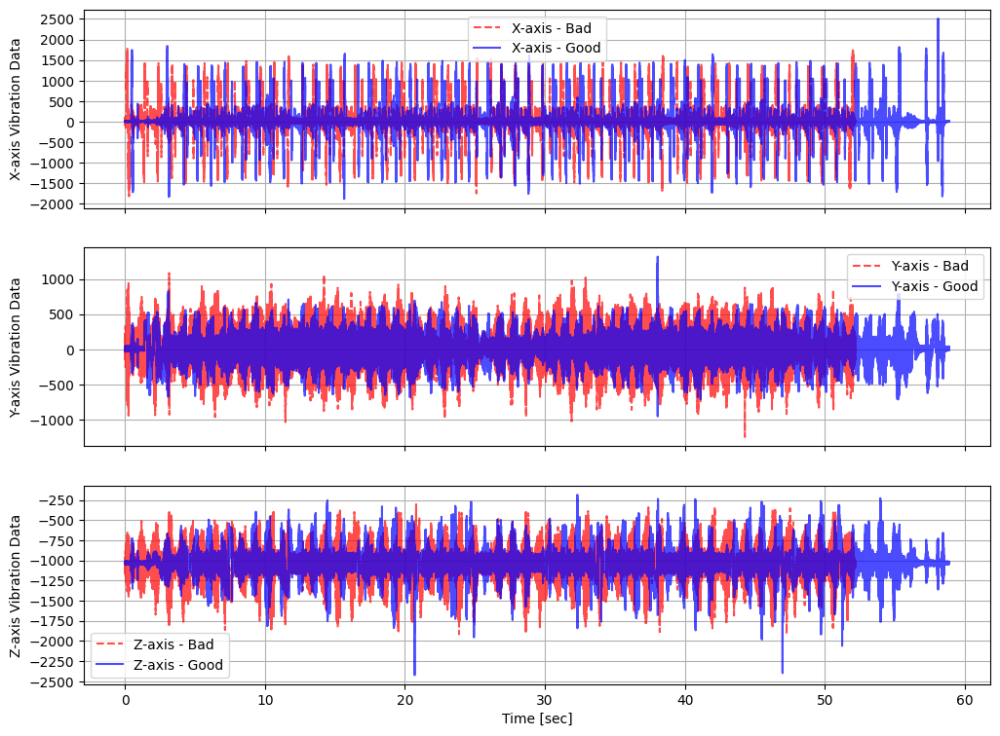

In [45]:
 # Example usage:
files=['../data/final/whole/M02/OP11/bad/M02_Feb_2019_OP11_000.h5',
       '../data/final/whole/M02/OP11/good/M02_Aug_2019_OP11_005.h5']

data = datafile_read(files, dataset_labels)


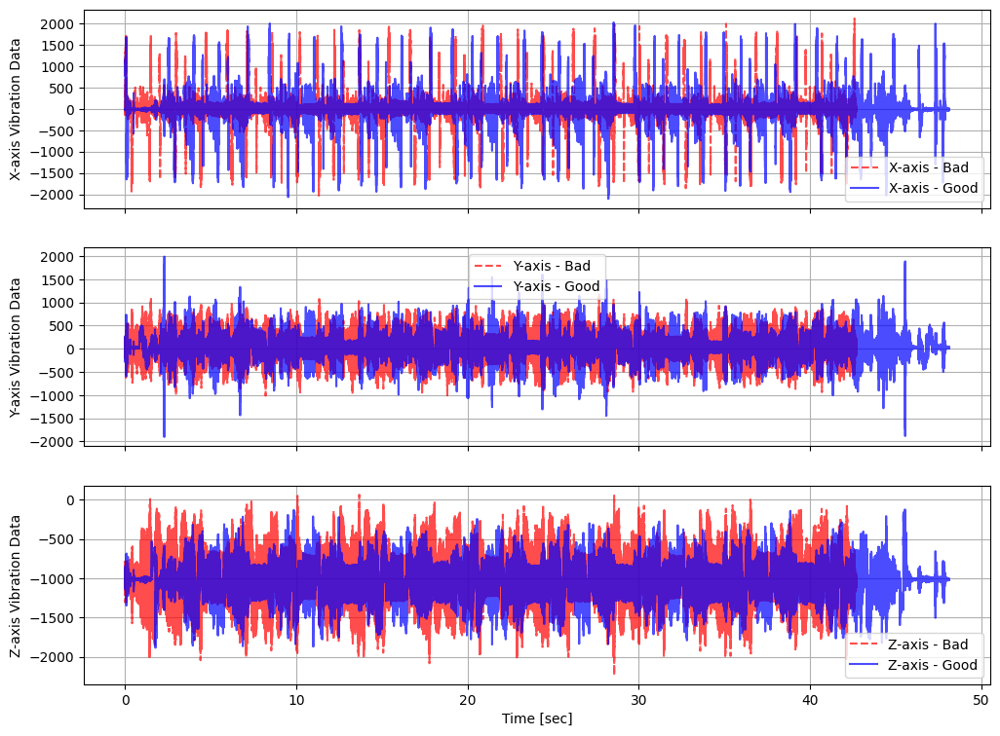

In [46]:
 # Example usage:
files=['../data/final/whole/M01/OP12/bad/M01_Feb_2019_OP12_000.h5',
       '../data/final/whole/M01/OP12/good/M01_Feb_2021_OP12_006.h5']

data = datafile_read(files, dataset_labels)


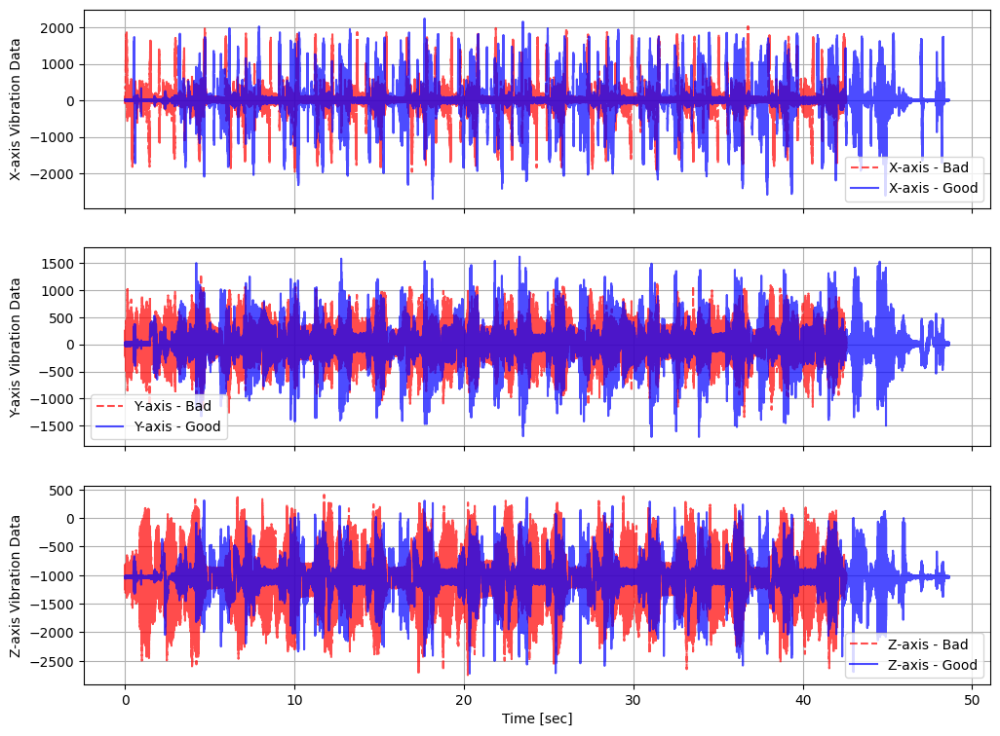

In [47]:
 # Example usage:
files=['../data/final/whole/M02/OP12/bad/M02_Feb_2019_OP12_000.h5',
       '../data/final/whole/M02/OP12/good/M02_Aug_2019_OP12_004.h5']

data = datafile_read(files, dataset_labels)


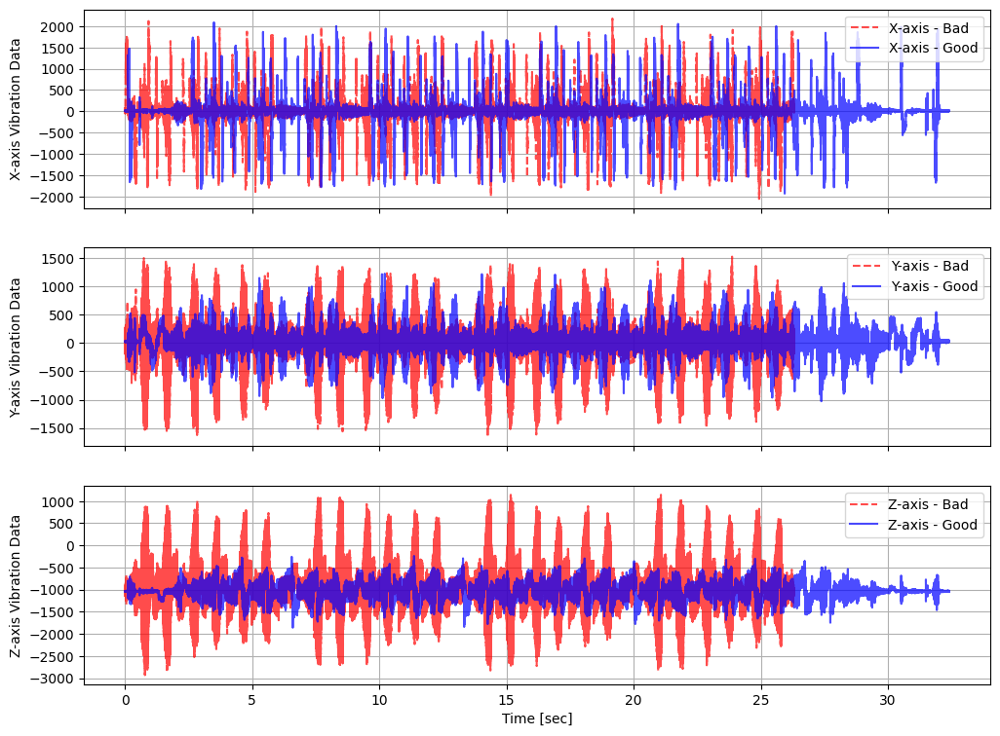

In [48]:
 # Example usage:
files=['../data/final/whole/M01/OP14/bad/M01_Feb_2019_OP14_000.h5',
       '../data/final/whole/M01/OP14/good/M01_Feb_2019_OP14_002.h5']

data = datafile_read(files, dataset_labels)


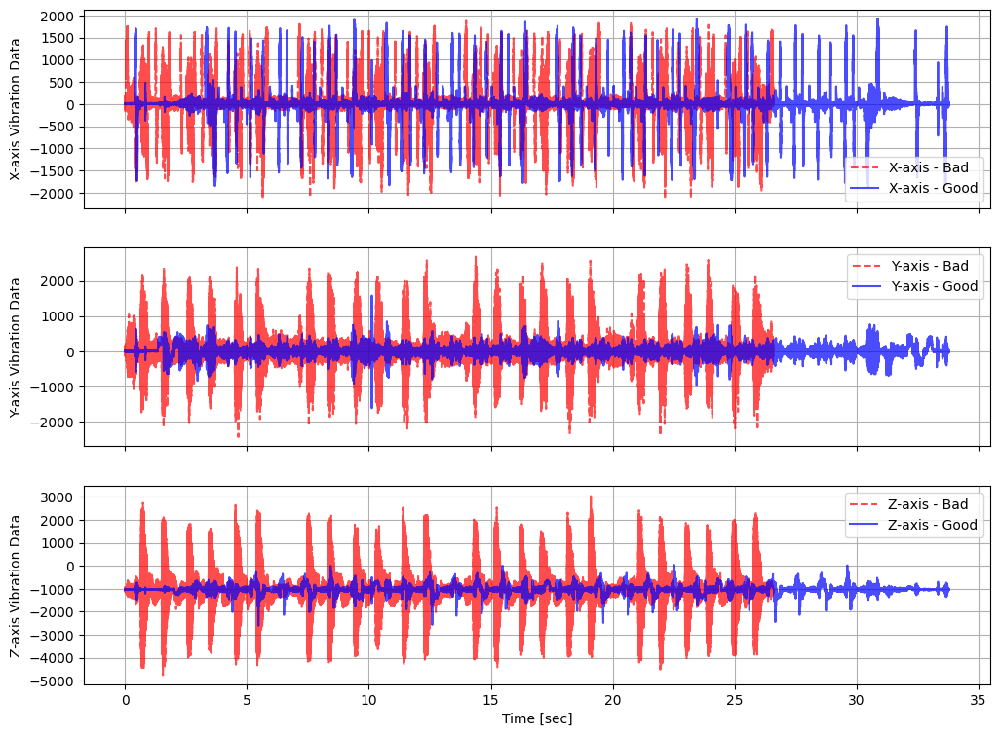

In [49]:
 # Example usage:
files=['../data/final/whole/M02/OP14/bad/M02_Feb_2019_OP14_000.h5',
       '../data/final/whole/M02/OP14/good/M02_Aug_2019_OP14_020.h5']

data = datafile_read(files, dataset_labels)


In [13]:
# Define a function to group the dataset into 'good' and 'bad' folders
def group_dataset(machines, selected_operations, new_root, data_root):
    grouped_data = []
    selected_data_dir = Path(new_root) / "Selected_data_grouped"
    selected_data_dir.mkdir(exist_ok=True)
    print(f"Directory '{selected_data_dir}' created")

    bad_data_dir = selected_data_dir / "bad"
    good_data_dir = selected_data_dir / "good"

    bad_data_dir.mkdir(exist_ok=True)
    print(f"Directory '{bad_data_dir}' created")

    good_data_dir.mkdir(exist_ok=True)
    print(f"Directory '{good_data_dir}' created")

    for machine in machines:
        for operation in selected_operations:
            bad_folder = Path(data_root) / machine / operation / 'bad'
            good_folder = Path(data_root) / machine / operation / 'good'

            # Get the list of bad files
            if bad_folder.exists():
                bad_files = [file for file in bad_folder.iterdir() if file.is_file() and file.suffix == '.h5']

            for file in bad_files:
                if not bad_folder.exists():
                    print(f"Skipping missing folder: {bad_folder}")
                    continue
                dest_bad = bad_data_dir / file.name
                try:
                    shutil.copy2(file, dest_bad)
                    print(f"Copied '{file}' to '{dest_bad}'")
                except shutil.Error as e:
                    print(f"Error occurred while copying file: {e}")
                except IOError as e:
                    print(f"Error occurred while accessing file: {e.strerror}")

                grouped_data.append((machine, operation, 'bad', file.name))

            # Get the list of good files
            good_files = [file for file in good_folder.iterdir() if file.is_file() and file.suffix == '.h5']

            for file in good_files:
                dest_good = good_data_dir / file.name
                try:
                    shutil.copy2(file, dest_good)
                    print(f"Copied '{file}' to '{dest_good}'")
                except shutil.Error as e:
                    print(f"Error occurred while copying file: {e}")
                except IOError as e:
                    print(f"Error occurred while accessing file: {e.strerror}")

                grouped_data.append((machine, operation, 'good', file.name))

    return grouped_data

In [14]:
# Step 1: Selected Data
selected_operations = ['OP01', 'OP02', 'OP04','OP05', 'OP06', 'OP07', 'OP08','OP10','OP11','OP12','OP14']
machines = ['M01', 'M02']
data_root = Path("../data/whole")


In [90]:
# group the dataset into 'good' and 'bad' folders
data_root = Path("../data/final/whole")
new_root = Path("../data/final/new_selection")

grouped_data = group_dataset(machines, selected_operations, new_root, data_root)
print(len(grouped_data), grouped_data)

Directory '..\data\final\new_selection\Selected_data_grouped' created
Directory '..\data\final\new_selection\Selected_data_grouped\bad' created
Directory '..\data\final\new_selection\Selected_data_grouped\good' created
Copied '..\data\final\whole\M01\OP01\bad\M01_Aug_2019_OP01_000.h5' to '..\data\final\new_selection\Selected_data_grouped\bad\M01_Aug_2019_OP01_000.h5'
Copied '..\data\final\whole\M01\OP01\bad\M01_Feb_2019_OP01_000.h5' to '..\data\final\new_selection\Selected_data_grouped\bad\M01_Feb_2019_OP01_000.h5'
Copied '..\data\final\whole\M01\OP01\good\M01_Aug_2019_OP01_000.h5' to '..\data\final\new_selection\Selected_data_grouped\good\M01_Aug_2019_OP01_000.h5'
Copied '..\data\final\whole\M01\OP01\good\M01_Aug_2019_OP01_001.h5' to '..\data\final\new_selection\Selected_data_grouped\good\M01_Aug_2019_OP01_001.h5'
Copied '..\data\final\whole\M01\OP01\good\M01_Aug_2019_OP01_002.h5' to '..\data\final\new_selection\Selected_data_grouped\good\M01_Aug_2019_OP01_002.h5'
Copied '..\data\fina

In [91]:
# Normalize the data based on good data

# Define directories
input_root = Path("../data/final/new_selection/Selected_data_grouped")
output_root = Path("../data/final/new_selection/Normalized_data")

output_root.mkdir(exist_ok=True)

# Get list of all machine-operation combinations
machine_operations = {}

for label in ['bad', 'good']:
    input_folder = input_root / label
    if not input_folder.exists():
        print(f"Skipping missing folder: {input_folder}")
        continue

    for file_path in input_folder.glob("*.h5"):
        file_name = file_path.name
        parts = file_name.split('_')  # Example: M01_Aug_2019_OP01_002.h5
        machine = parts[0]  # e.g., M01
        operation = parts[3]  # e.g., OP01
        key = f"{machine}_{operation}"

        if key not in machine_operations:
            machine_operations[key] = []
        machine_operations[key].append(file_path)

# Step 1: Compute mean & std per machine-operation
machine_operation_stats = {}
for key, files in machine_operations.items():
    all_data = []
    for file_path in files:
        if 'bad' in str(file_path):  # Skip bad samples
            continue
        with h5py.File(file_path, 'r') as file:
            vibration_data = file['vibration_data'][:]
            all_data.append(vibration_data)
    if not all_data:  # Skip if no good samples
        continue
    all_data = np.vstack(all_data)
    mean_vals = np.mean(all_data, axis=0)
    std_vals = np.std(all_data, axis=0)
    std_vals[std_vals == 0] = 1
    machine_operation_stats[key] = (mean_vals, std_vals)
    print(f"Computed Mean & Std for {key} → Mean: {mean_vals}, Std: {std_vals}")

# Step 2: Normalize each file using its machine-operation group stats
for key, files in machine_operations.items():
    mean_vals, std_vals = machine_operation_stats[key]

    for file_path in files:
        with h5py.File(file_path, 'r') as file:
            vibration_data = file['vibration_data'][:]

        # Debug: Print mean/std of a sample before normalization
        print(f"\nBefore Normalization ({file_path.name}):")
        print("Mean:", np.mean(vibration_data, axis=0))
        print("Std:", np.std(vibration_data, axis=0))

        # Normalize using machine-operation-specific mean & std
        normalized_data = (vibration_data - mean_vals) / std_vals

        # Debug: Print mean/std after normalization to verify correctness
        print(f"After Normalization ({file_path.name}):")
        print("Mean:", np.mean(normalized_data, axis=0))
        print("Std:", np.std(normalized_data, axis=0))

        # Define output path using pathlib
        label = "bad" if "bad" in str(file_path) else "good"
        output_folder = output_root / label
        output_folder.mkdir(parents=True, exist_ok=True)

        output_file_path = output_folder / file_path.name

        # Save the normalized data
        with h5py.File(output_file_path, 'w') as new_file:
            new_file.create_dataset('vibration_data', data=normalized_data)

        print(f"✅ Saved normalized file: {output_file_path}")

print("\n✅ Normalization complete! All files saved in:", output_root)


Computed Mean & Std for M01_OP01 → Mean: [   -2.32173825    33.29547292 -1017.460291  ], Std: [425.77432777 157.34901354 174.86376634]
Computed Mean & Std for M01_OP04 → Mean: [   -2.16062803    33.30566777 -1017.8174474 ], Std: [432.32540209 179.15888208 175.84934453]
Computed Mean & Std for M01_OP05 → Mean: [   -4.12401622    32.17625188 -1016.45648489], Std: [350.9975857  153.94373409 144.23045325]
Computed Mean & Std for M01_OP06 → Mean: [   -1.10997249    34.78755095 -1017.81683454], Std: [340.67358373 172.61016298 163.66235101]
Computed Mean & Std for M01_OP07 → Mean: [   -3.07609405    33.54953947 -1017.23788681], Std: [412.15623661 185.75367436 139.82352285]
Computed Mean & Std for M01_OP10 → Mean: [   -1.96727999    33.11927268 -1016.00092299], Std: [423.93092085 174.27288322 175.1424055 ]
Computed Mean & Std for M01_OP02 → Mean: [   -2.48225111    32.67739302 -1016.80922787], Std: [380.42525933 162.33219349 163.98205636]
Computed Mean & Std for M01_OP08 → Mean: [   -1.9492037

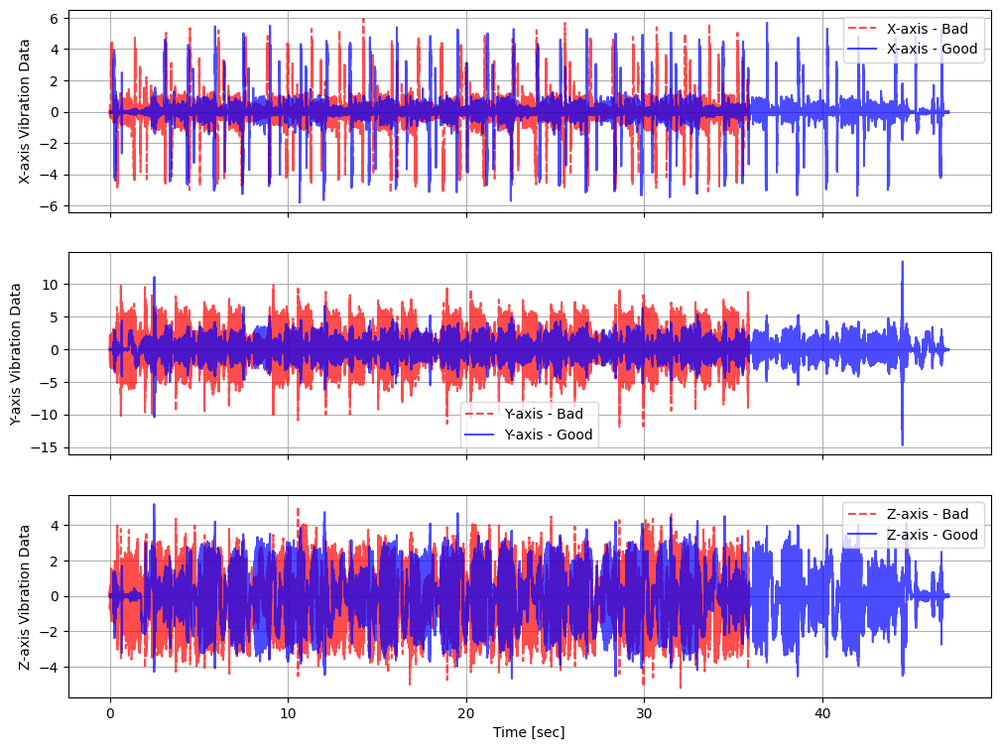

In [93]:
 # Example usage
files=['../data/final/new_selection/Normalized_data/bad/M01_Feb_2019_OP02_000.h5',
       '../data/final/new_selection/Normalized_data/good/M01_Aug_2019_OP02_007.h5']

data = datafile_read(files)

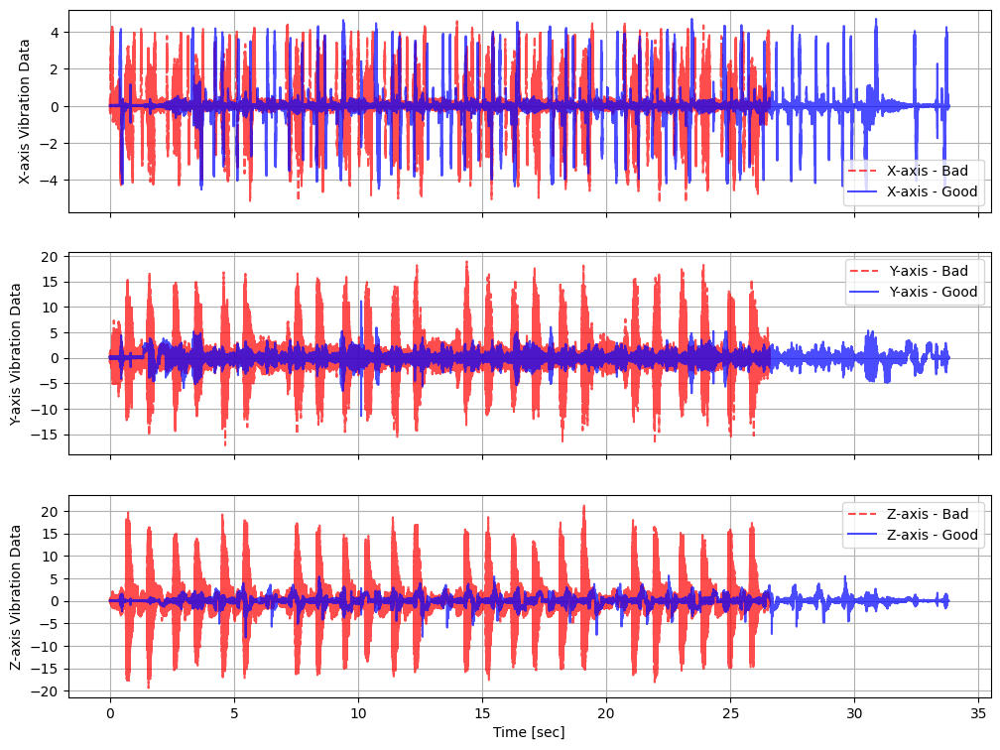

In [56]:
 # Example usage:
files=['../data/final/new_selection/Normalized_data/bad/M02_Feb_2019_OP14_000.h5',
       '../data/final/new_selection/Normalized_data/good/M02_Aug_2019_OP14_020.h5']

data = datafile_read(files, dataset_labels)


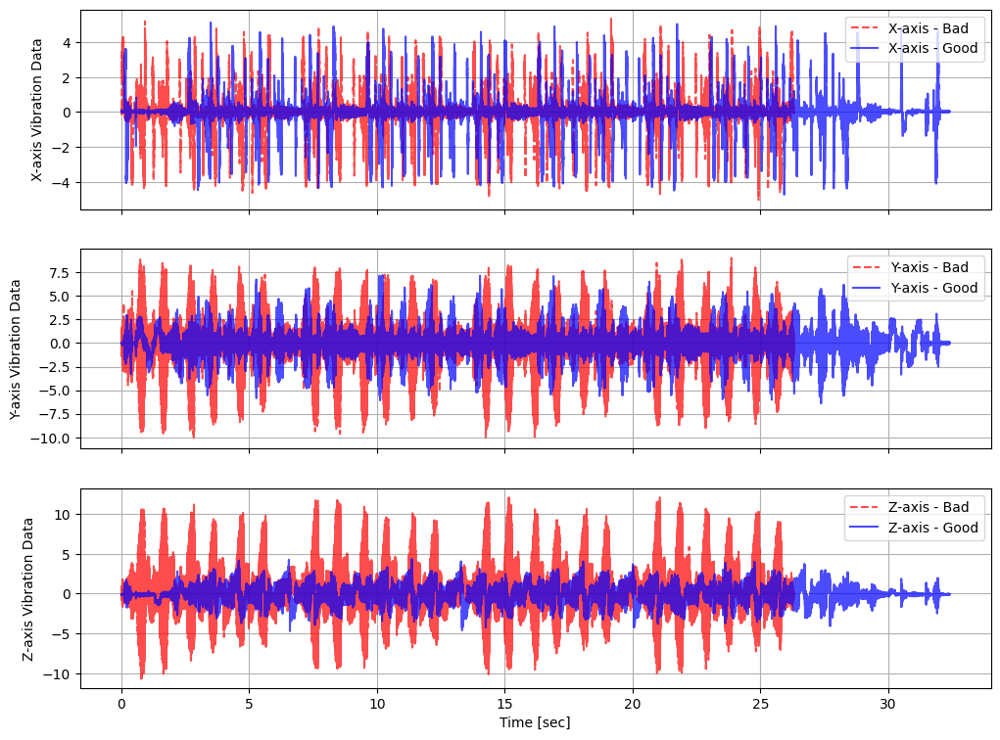

In [106]:
 # Example usage:
files=['../data/final/new_selection/Normalized_data/bad/M01_Feb_2019_OP14_000.h5',
       '../data/final/new_selection/Normalized_data/good/M01_Feb_2019_OP14_002.h5']

data = datafile_read(files, dataset_labels)


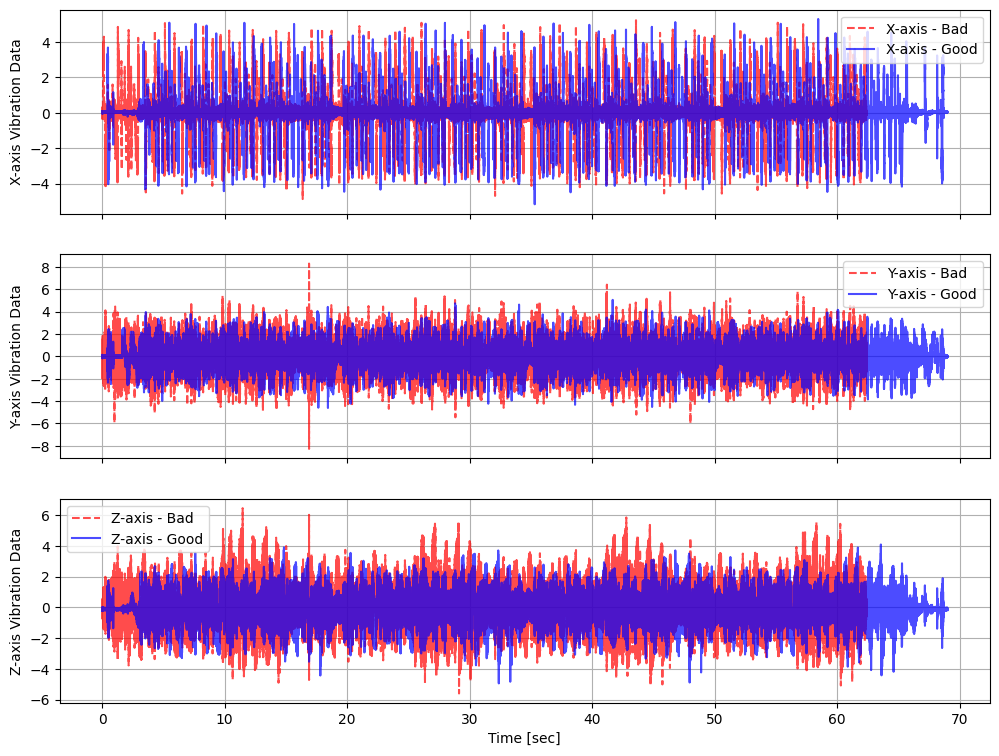

In [57]:
 # Example usage:
files=['../data/final/new_selection/Normalized_data/bad/M01_Feb_2019_OP04_000.h5',
       '../data/final/new_selection/Normalized_data/good/M01_Feb_2019_OP04_000.h5']
dataset_labels = ["Bad Dataset", "Good Dataset"]  # Add labels for your datasets

data = datafile_read(files, dataset_labels)


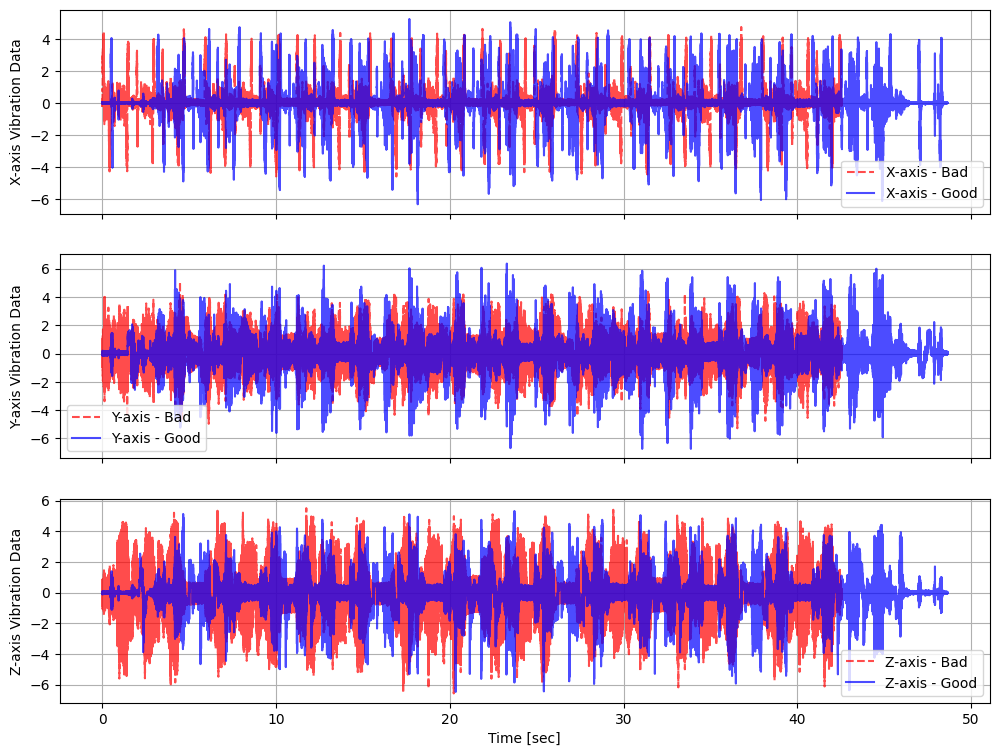

In [58]:
 # Example usage:
files=['../data/final/new_selection/Normalized_data/bad/M02_Feb_2019_OP12_000.h5',
       '../data/final/new_selection/Normalized_data/good/M02_Aug_2019_OP12_004.h5']

data = datafile_read(files, dataset_labels)


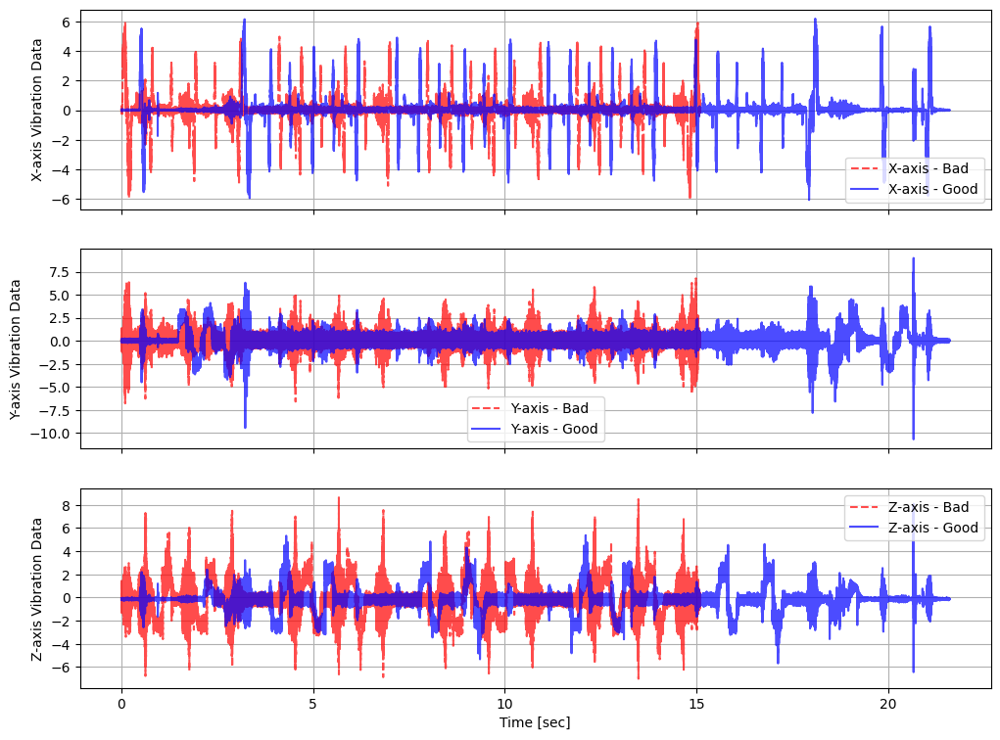

In [59]:
 # Example usage:
files=['../data/final/new_selection/Normalized_data/bad/M02_Feb_2019_OP05_000.h5',
       '../data/final/new_selection/Normalized_data/good/M02_Feb_2019_OP05_000.h5']

data = datafile_read(files, dataset_labels)


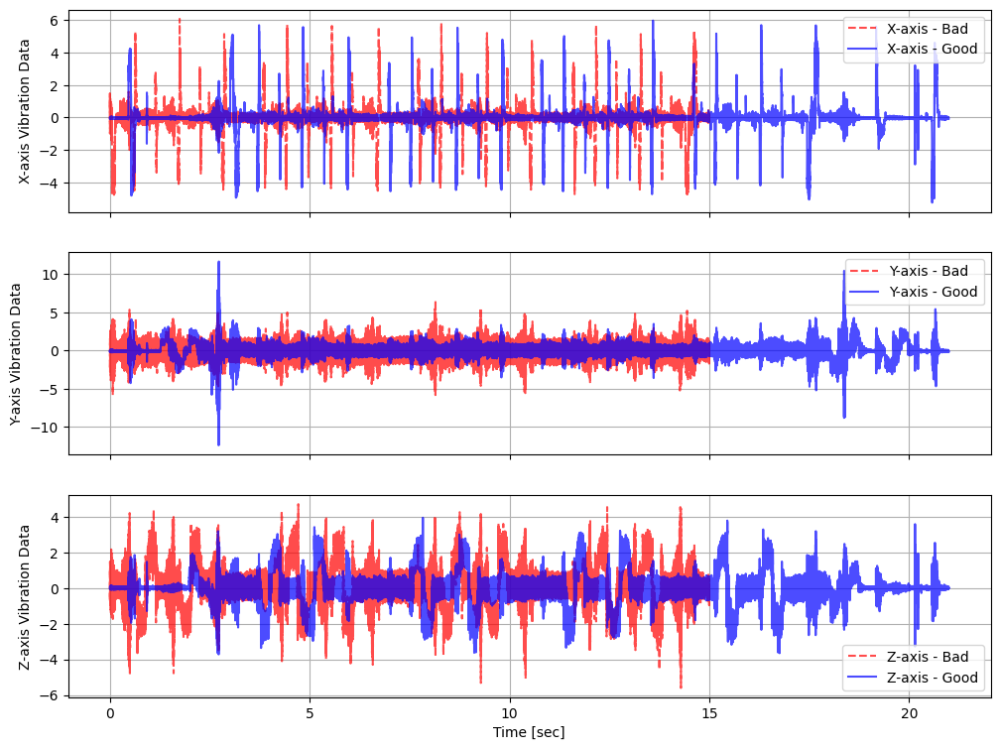

In [62]:
 # Example usage:
files=['../data/final/new_selection/Normalized_data/bad/M01_Feb_2021_OP05_000.h5',
       '../data/final/new_selection/Normalized_data/good/M01_Feb_2021_OP05_003.h5']

data = datafile_read(files, dataset_labels)


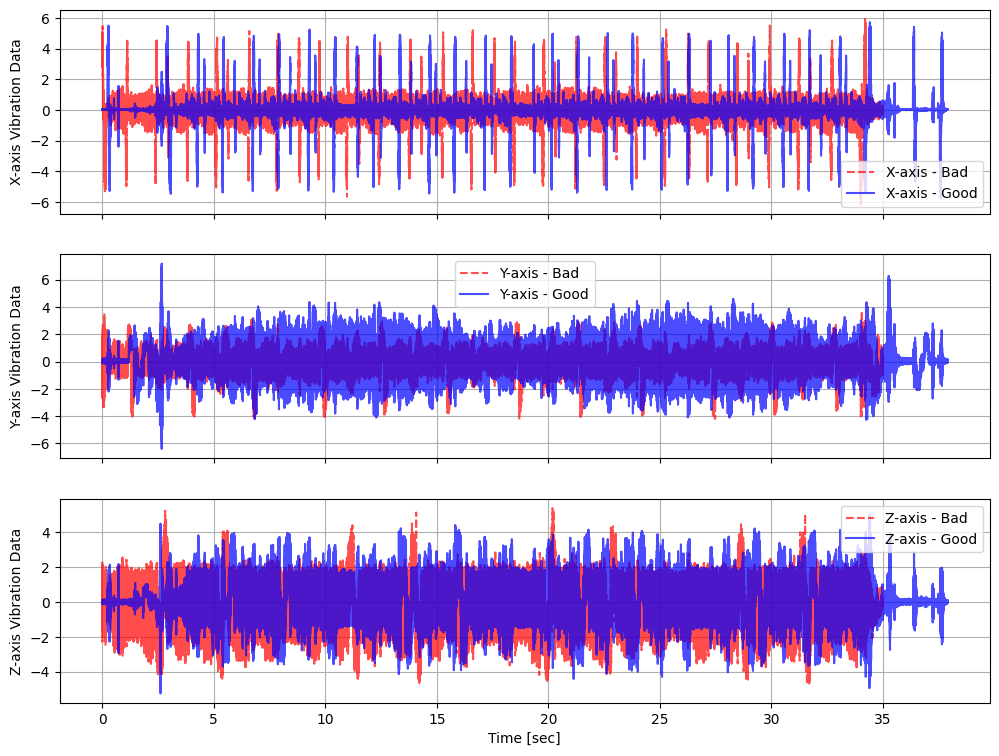

In [78]:
 # Example usage:
files=['../data/final/new_selection/Normalized_data/bad/M02_Aug_2021_OP08_000.h5',
       '../data/final/new_selection/Normalized_data/good/M02_Feb_2020_OP08_000.h5']

data = datafile_read(files, dataset_labels)


In [15]:
def compute_fft(signal, sampling_rate=2000):
    """Calculates the FFT of a signal.

    Args:
        signal: The time-domain signal (a NumPy array).
        sampling_rate: The sampling rate of the signal in Hz.

    Returns:
        (frequencies, fft_values): A tuple containing:
            * frequencies: An array of frequencies corresponding to the FFT bins.
            * fft_values: An array of complex FFT values.
    """

    signal_length = len(signal)
    fft_values = np.fft.fft(signal)  # Calculate the FFT
    frequencies = np.fft.fftfreq(signal_length, d=1/sampling_rate)  # Frequencies

    # Keep only positive frequencies for real-world signals
    positive_indices = frequencies >= 0
    frequencies = frequencies[positive_indices]
    fft_values = fft_values[positive_indices]

    return frequencies, fft_values


E:\Thesis\Datasets\CNC\.venv_cnc\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
E:\Thesis\Datasets\CNC\.venv_cnc\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


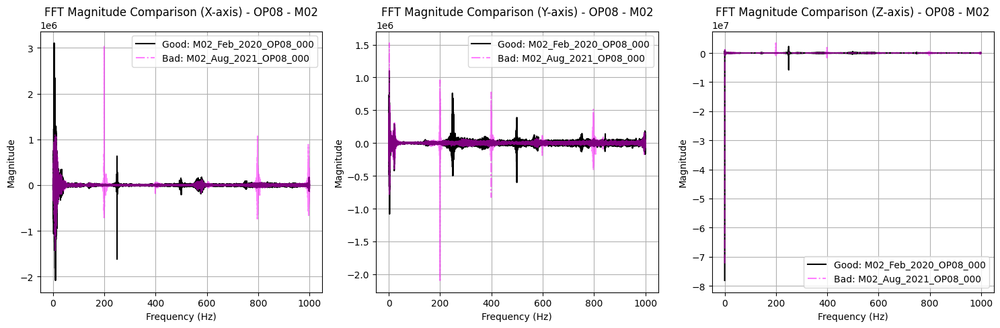

In [15]:
#Apply FFT on the bad sample and the corresponding good sample of the same year and month

sampling_freq = 2000

bad_h5 = '../data/final/new_selection/Selected_data_grouped/bad/M02_Aug_2021_OP08_000.h5'
good_h5 =  '../data/final/new_selection/Selected_data_grouped/good/M02_Feb_2020_OP08_000.h5'

with h5py.File(bad_h5, 'r') as f:
    bad_data_x = f['vibration_data'][:, 0]
    bad_data_y = f['vibration_data'][:, 1]
    bad_data_z = f['vibration_data'][:, 2]
# Compute FFT for bad sample (X-axis)
freqs_bad_x, magnitudes_bad_x = compute_fft(bad_data_x, sampling_freq)
freqs_bad_y, magnitudes_bad_y = compute_fft(bad_data_y, sampling_freq)
freqs_bad_z, magnitudes_bad_z = compute_fft(bad_data_z, sampling_freq)
# Load and compute FFT for corresponding good sample
with h5py.File(good_h5, 'r') as f1:
    good_data_x = f1['vibration_data'][:, 0]
    good_data_y = f1['vibration_data'][:, 1]
    good_data_z = f1['vibration_data'][:, 2]
# Compute FFT for good sample (X-axis)
freqs_good_x, magnitudes_good_x = compute_fft(good_data_x, sampling_freq)
freqs_good_y, magnitudes_good_y = compute_fft(good_data_y, sampling_freq)
freqs_good_z, magnitudes_good_z = compute_fft(good_data_z, sampling_freq)

# Get the names of the good and bad sample files
good_sample_name = 'M02_Feb_2020_OP08_000'
bad_sample_name = 'M02_Aug_2021_OP08_000'
parts = good_sample_name.split('_')  # Example: M01_Aug_2019_OP01_002.h5
machine = parts[0]  # e.g., M01
operation = parts[3]  # e.g., OP01

# Plot FFT magnitudes for comparison
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(freqs_good_x, magnitudes_good_x, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_x, magnitudes_bad_x, label=f'Bad: {bad_sample_name}' , color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (X-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.subplot(1, 3, 2)
plt.plot(freqs_good_y, magnitudes_good_y, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_y, magnitudes_bad_y, label=f'Bad: {bad_sample_name}', color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (Y-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.subplot(1, 3, 3)
plt.plot(freqs_good_z, magnitudes_good_z, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_z, magnitudes_bad_z, label=f'Bad: {bad_sample_name}',color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (Z-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


E:\Thesis\Datasets\CNC\.venv_cnc\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
E:\Thesis\Datasets\CNC\.venv_cnc\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


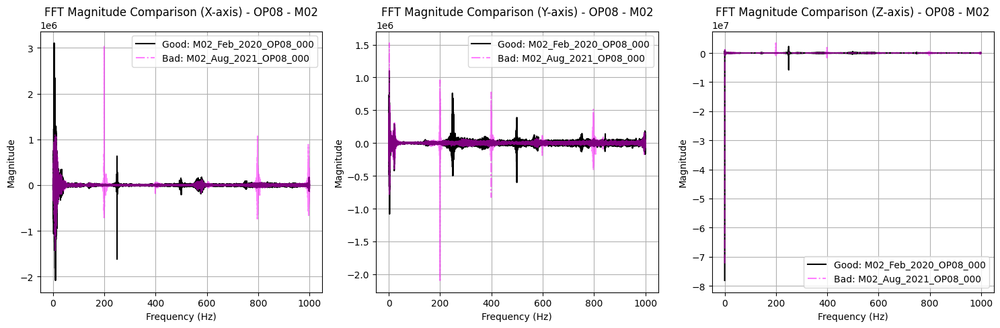

In [5]:
#Apply FFT on the bad sample and the corresponding good sample of the same year and month

sampling_freq = 2000

bad_h5 = '../data/final/whole/M02/OP08//bad/M02_Aug_2021_OP08_000.h5'
good_h5 =  '../data/final//whole/M02/OP08/good/M02_Feb_2020_OP08_000.h5'

with h5py.File(bad_h5, 'r') as f:
    bad_data_x = f['vibration_data'][:, 0]
    bad_data_y = f['vibration_data'][:, 1]
    bad_data_z = f['vibration_data'][:, 2]
# Compute FFT for bad sample (X-axis)
freqs_bad_x, magnitudes_bad_x = compute_fft(bad_data_x, sampling_freq)
freqs_bad_y, magnitudes_bad_y = compute_fft(bad_data_y, sampling_freq)
freqs_bad_z, magnitudes_bad_z = compute_fft(bad_data_z, sampling_freq)
# Load and compute FFT for corresponding good sample
with h5py.File(good_h5, 'r') as f1:
    good_data_x = f1['vibration_data'][:, 0]
    good_data_y = f1['vibration_data'][:, 1]
    good_data_z = f1['vibration_data'][:, 2]
# Compute FFT for good sample (X-axis)
freqs_good_x, magnitudes_good_x = compute_fft(good_data_x, sampling_freq)
freqs_good_y, magnitudes_good_y = compute_fft(good_data_y, sampling_freq)
freqs_good_z, magnitudes_good_z = compute_fft(good_data_z, sampling_freq)

# Get the names of the good and bad sample files
good_sample_name = 'M02_Feb_2020_OP08_000'
bad_sample_name = 'M02_Aug_2021_OP08_000'
parts = good_sample_name.split('_')  # Example: M01_Aug_2019_OP01_002.h5
machine = parts[0]  # e.g., M01
operation = parts[3]  # e.g., OP01

# Plot FFT magnitudes for comparison
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(freqs_good_x, magnitudes_good_x, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_x, magnitudes_bad_x, label=f'Bad: {bad_sample_name}' , color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (X-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.subplot(1, 3, 2)
plt.plot(freqs_good_y, magnitudes_good_y, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_y, magnitudes_bad_y, label=f'Bad: {bad_sample_name}', color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (Y-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.subplot(1, 3, 3)
plt.plot(freqs_good_z, magnitudes_good_z, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_z, magnitudes_bad_z, label=f'Bad: {bad_sample_name}',color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (Z-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


E:\Thesis\Datasets\CNC\.venv_cnc\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
E:\Thesis\Datasets\CNC\.venv_cnc\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


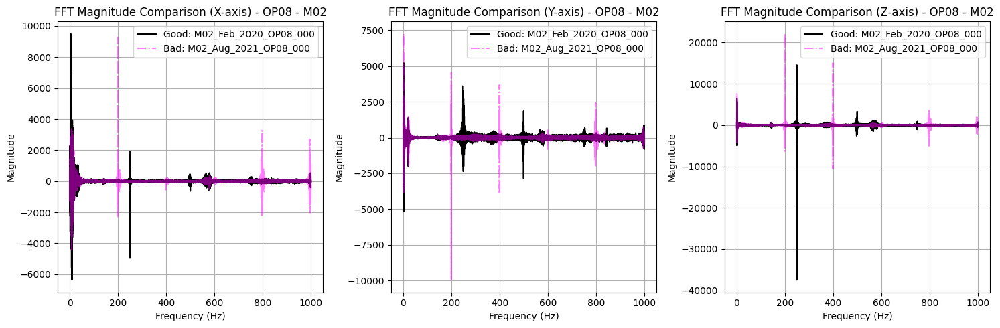

In [16]:
#Apply FFT on the bad sample and the corresponding good sample of the same year and month

sampling_freq = 2000

bad_h5 = '../data/final/new_selection/Normalized_data/bad/M02_Aug_2021_OP08_000.h5'
good_h5 =  '../data/final/new_selection/Normalized_data/good/M02_Feb_2020_OP08_000.h5'

with h5py.File(bad_h5, 'r') as f:
    bad_data_x = f['vibration_data'][:, 0]
    bad_data_y = f['vibration_data'][:, 1]
    bad_data_z = f['vibration_data'][:, 2]
# Compute FFT for bad sample (X-axis)
freqs_bad_x, magnitudes_bad_x = compute_fft(bad_data_x, sampling_freq)
freqs_bad_y, magnitudes_bad_y = compute_fft(bad_data_y, sampling_freq)
freqs_bad_z, magnitudes_bad_z = compute_fft(bad_data_z, sampling_freq)
# Load and compute FFT for corresponding good sample
with h5py.File(good_h5, 'r') as f1:
    good_data_x = f1['vibration_data'][:, 0]
    good_data_y = f1['vibration_data'][:, 1]
    good_data_z = f1['vibration_data'][:, 2]
# Compute FFT for good sample (X-axis)
freqs_good_x, magnitudes_good_x = compute_fft(good_data_x, sampling_freq)
freqs_good_y, magnitudes_good_y = compute_fft(good_data_y, sampling_freq)
freqs_good_z, magnitudes_good_z = compute_fft(good_data_z, sampling_freq)

# Get the names of the good and bad sample files
good_sample_name = 'M02_Feb_2020_OP08_000'
bad_sample_name = 'M02_Aug_2021_OP08_000'
# Plot FFT magnitudes for comparison
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(freqs_good_x, magnitudes_good_x, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_x, magnitudes_bad_x, label=f'Bad: {bad_sample_name}' , color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (X-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.subplot(1, 3, 2)
plt.plot(freqs_good_y, magnitudes_good_y, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_y, magnitudes_bad_y, label=f'Bad: {bad_sample_name}', color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (Y-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.subplot(1, 3, 3)
plt.plot(freqs_good_z, magnitudes_good_z, label=f'Good: {good_sample_name}', color='black')
plt.plot(freqs_bad_z, magnitudes_bad_z, label=f'Bad: {bad_sample_name}',color='magenta', linestyle='dashdot', alpha=0.5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title(f'FFT Magnitude Comparison (Z-axis) - {operation} - {machine}')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [16]:
def trim_and_window(time_series, label):
    """
    Trim the time series (for GOOD samples) and create 5-second windows.
    GOOD samples: Trim up to 3 seconds from both ends (adjust if signal is short), non-overlapping windows.
    BAD samples: No trimming, overlapping windows (2.5-second slide).

    Args:
        time_series (np.array): The time series data (shape: [time_steps, 3] for X, Y, Z).
        label (str): "GOOD" or "BAD" indicating the class of the time series.

    Returns:
        List of 5-second windows.
    """
    total_len = time_series.shape[0]  # Total number of data points
    print(f"Total length of time series: {total_len} data points ({total_len / sampling_rate:.2f} seconds)")

    # Minimum length to produce at least one 5-second window
    min_length = window_size  # 10,000 points (5 seconds)

    if total_len < min_length:
        print(f"Time series too short to create a 5-second window: {total_len} data points ({total_len / sampling_rate:.2f} seconds), skipping")
        return []

    if label == 'BAD':
        # No trimming for bad samples to preserve anomaly information
        trimmed_series = time_series
        print("No trimming for BAD class")

        # Overlapping windows (2.5-second slide)
        windows = []
        for i in range(0, total_len - window_size + 1, overlap_slide):
            window = trimmed_series[i:i + window_size]
            if window.shape[0] == window_size:  # Ensure full window
                windows.append(window)
        print(f"Number of overlapping 5-second windows (1-second slide) for BAD class: {len(windows)}")

    elif label == 'GOOD':
        # Dynamically adjust trimming based on signal length
        # Goal: Ensure at least one 5-second window after trimming
        # Ideal trim: 3 seconds each side (6000 points)
        # Minimum length to trim 2 seconds each side: 2 * 4000 + 10,000 = 18,000 points (9 seconds)  or 2 * 6,000 + 10,000 = 22,000 points (11 seconds)

        if total_len >= 2 * max_trim_points + window_size:  # Can trim full 3 seconds
            trim_points = max_trim_points
            trimmed_series = time_series[trim_points:total_len - trim_points]
            print(f"Trimmed {trim_points} data points ({max_trim_seconds} seconds) from each side for GOOD class")
        else:
            # Adjust trim to ensure at least one window
            # Need: total_len - 2 * trim_points >= window_size
            # So: 2 * trim_points <= total_len - window_size
            # trim_points <= (total_len - window_size) / 2
            max_possible_trim = (total_len - window_size) // 2
            trim_points = min(max_possible_trim, max_trim_points)  # Don't trim more than max_trim_points
            if trim_points < 0:  # If signal is too short to trim and get a window, this was caught earlier
                trim_points = 0
            trimmed_series = time_series[trim_points:total_len - trim_points]
            print(f"Adjusted trim for short signal: Trimmed {trim_points} data points ({trim_points / sampling_rate:.2f} seconds) from each side for GOOD class")

        print(f"Trimmed time series length: {trimmed_series.shape[0]} data points ({trimmed_series.shape[0] / sampling_rate:.2f} seconds)")

        # Non-overlapping windows (5-second slide)
        windows = []
        for i in range(0, trimmed_series.shape[0] - window_size + 1, window_size):
            window = trimmed_series[i:i + window_size]
            if window.shape[0] == window_size:  # Ensure full window
                windows.append(window)
        print(f"Number of non-overlapping 5-second windows for GOOD class: {len(windows)}")

    return windows


In [17]:
def process_and_save_windows(label, folder):
    """
    Processes and saves the 5-second windows for a given label (GOOD or BAD) as .h5 files.

    Args:
        label (str): 'good' or 'bad'.
        folder (Path): Path to the 'good' or 'bad' folder.
    """
    # Create save directory
    save_dir = windowed_root / label
    save_dir.mkdir(parents=True, exist_ok=True)
    print(f"\nProcessing {label.upper()} files in {folder}")

    # Process each h5 file in the folder
    for h5_file in folder.glob("*.h5"):
        print(f"Processing file: {h5_file}")
        with h5py.File(h5_file, 'r') as f:
            if 'vibration_data' not in f:
                print(f"No 'vibration_data' dataset in file: {h5_file}")
                continue

            vibration_data = f['vibration_data'][:]
            print(f"Loaded time series data of shape {vibration_data.shape}")

            # Trim and create windows
            windows = trim_and_window(vibration_data, label.upper())

            # Save each window as a new .h5 file
            for idx, window in enumerate(windows):
                window_filename = save_dir / f"{h5_file.stem}_window_{idx}.h5"
                with h5py.File(window_filename, 'w') as hf:
                    hf.create_dataset('vibration_data', data=window)
                    print(f"Saved window {idx} for {h5_file.stem} to {window_filename}")


In [10]:
#implement trim and Window

# Define paths and parameters
data_root = Path("../data/final/new_selection/Normalized_data")
windowed_root = Path("../data/final/new_selection/normalized_windowed_data_lessBAD")

# Windowing parameters
sampling_rate = 2000  # Hz (2 kHz)
window_size = 5 * sampling_rate  # 5 seconds in data points (10,000 points)
max_trim_seconds = 3  # Maximum seconds to trim from beginning and end of good samples
max_trim_points = max_trim_seconds * sampling_rate  # Maximum data points to trim (4000 points)
overlap_slide = int(2.5 * sampling_rate)  # 1-second slide for bad samples (5000 points)



# Process good and bad data
for label in ['good', 'bad']:
    folder = data_root / label
    if folder.exists():
        process_and_save_windows(label, folder)
    else:
        print(f"Folder not found: {folder}")

print("\n✅ Windowing complete! All windows saved in:", windowed_root)


Processing GOOD files in ..\data\final\new_selection\Normalized_data\good
Processing file: ..\data\final\new_selection\Normalized_data\good\M01_Aug_2019_OP01_000.h5
Loaded time series data of shape (60416, 3)
Total length of time series: 60416 data points (30.21 seconds)
Trimmed 6000 data points (3 seconds) from each side for GOOD class
Trimmed time series length: 48416 data points (24.21 seconds)
Number of non-overlapping 5-second windows for GOOD class: 4
Saved window 0 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\normalized_windowed_data_lessBAD\good\M01_Aug_2019_OP01_000_window_0.h5
Saved window 1 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\normalized_windowed_data_lessBAD\good\M01_Aug_2019_OP01_000_window_1.h5
Saved window 2 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\normalized_windowed_data_lessBAD\good\M01_Aug_2019_OP01_000_window_2.h5
Saved window 3 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\normalized_windowed_data_lessBAD\

In [12]:
# Define paths for downsampling input and output
normalized_root = Path("../data/final/new_selection/normalized_windowed_data_lessBAD")
downsampled_root = Path("../data/final/new_selection/normalized_windowed_downsampled_data_lessBAD")

# Sampling rate and downsampling parameters
ORIGINAL_SAMPLE_RATE = 2000  # Hz
TARGET_SAMPLE_RATE = 400  # Hz (target effective sampling rate)
ORIGINAL_SAMPLES = 10000  # 5 seconds at 2000 Hz
TARGET_SAMPLES = ORIGINAL_SAMPLES * TARGET_SAMPLE_RATE // ORIGINAL_SAMPLE_RATE  # 2000 samples (5 seconds at 400 Hz)
DOWNSAMPLING_FACTOR = ORIGINAL_SAMPLES // TARGET_SAMPLES  # 5


# Create the downsampled root directory
downsampled_root.mkdir(exist_ok=True)
print(f"Directory '{downsampled_root}' created")


Directory '..\data\final\new_selection\normalized_windowed_downsampled_data_lessBAD' created


In [22]:
# Function to downsample a single time series using NumPy
def downsample_time_series(vibration_data, original_samples=ORIGINAL_SAMPLES, target_samples=TARGET_SAMPLES):
    """
    Downsample the vibration data using average pooling with NumPy.

    Args:
        vibration_data (np.array): Shape (10000, 3) - original vibration data (X, Y, Z axes).
        original_samples (int): Original number of samples (10000).
        target_samples (int): Target number of samples after downsampling (2000).

    Returns:
        downsampled_data (np.array): Shape (2000, 3) - downsampled vibration data.
    """
    # Validate input shape
    if vibration_data.shape[0] != original_samples:
        raise ValueError(f"Expected {original_samples} samples, but got {vibration_data.shape[0]} samples")
    if vibration_data.shape[1] != 3:
        raise ValueError(f"Expected 3 axes, but got {vibration_data.shape[1]} axes")

    # Calculate downsampling factor
    factor = original_samples // target_samples  # Should be 10

    # Reshape data to (target_samples, factor, 3) and average along the factor axis
    reshaped_data = vibration_data.reshape(target_samples, factor, 3)  # Shape: (2000, 5, 3)
    downsampled_data = np.mean(reshaped_data, axis=1)  # Shape: (2000, 3)

    return downsampled_data



In [23]:
# Function to process and save downsampled files
def downsample_and_save_files():
    """
    Downsample all .h5 files in the windowed_root directory and save them to downsampled_root.
    """
    # Iterate through both 'bad' and 'good' folders
    for sample_type in ["bad", "good"]:
        input_folder = windowed_root / sample_type
        output_folder = downsampled_root / sample_type

        # Create output folder
        output_folder.mkdir(exist_ok=True)
        print(f"Directory '{output_folder}' created")

        if not input_folder.exists():
            print(f"Skipping missing folder: {input_folder}")
            continue

        # Iterate through all .h5 files
        for h5_file in input_folder.glob("*.h5"):
            print(f"Processing file: {h5_file}")

            # Load the original data
            with h5py.File(h5_file, 'r') as f:
                vibration_data = f['vibration_data'][:]  # Shape: (10000, 3)
                print(f"Loaded time series data of shape {vibration_data.shape}")

            # Downsample the data
            try:
                downsampled_data = downsample_time_series(vibration_data, ORIGINAL_SAMPLES, TARGET_SAMPLES)
                print(f"Downsampled time series data to shape {downsampled_data.shape}")
            except ValueError as e:
                print(f"Error downsampling {h5_file}: {e}")
                continue

            # Define the new filename with "_downsampled" appended
            new_filename = f"{h5_file.stem}_downsampled.h5"
            output_path = output_folder / new_filename

            # Save the downsampled data
            with h5py.File(output_path, 'w') as hf:
                hf.create_dataset('vibration_data', data=downsampled_data)
                print(f"Saved downsampled file to {output_path}")



In [15]:
# Run the downsampling process
downsample_and_save_files()

# Verify the downsampled data
print("\nVerifying downsampled data:")
for sample_type in ["bad", "good"]:
    folder_path = downsampled_root / sample_type
    if not folder_path.exists():
        print(f"Skipping missing folder: {folder_path}")
        continue

    for file_path in folder_path.glob("*.h5"):
        with h5py.File(file_path, 'r') as file:
            vibration_data = file['vibration_data'][:]
            num_samples = vibration_data.shape[0]
            duration = num_samples / TARGET_SAMPLE_RATE  # Duration in seconds
            print(f"{sample_type.upper()} - {file_path.name}: Duration {duration:.2f}s, Shape {vibration_data.shape}")

Directory '..\data\final\new_selection\normalized_windowed_downsampled_data_lessBAD\bad' created
Processing file: ..\data\final\new_selection\normalized_windowed_data_lessBAD\bad\M01_Aug_2019_OP01_000_window_0.h5
Loaded time series data of shape (10000, 3)
Downsampled time series data to shape (2000, 3)
Saved downsampled file to ..\data\final\new_selection\normalized_windowed_downsampled_data_lessBAD\bad\M01_Aug_2019_OP01_000_window_0_downsampled.h5
Processing file: ..\data\final\new_selection\normalized_windowed_data_lessBAD\bad\M01_Aug_2019_OP01_000_window_1.h5
Loaded time series data of shape (10000, 3)
Downsampled time series data to shape (2000, 3)
Saved downsampled file to ..\data\final\new_selection\normalized_windowed_downsampled_data_lessBAD\bad\M01_Aug_2019_OP01_000_window_1_downsampled.h5
Processing file: ..\data\final\new_selection\normalized_windowed_data_lessBAD\bad\M01_Aug_2019_OP01_000_window_2.h5
Loaded time series data of shape (10000, 3)
Downsampled time series data 

In [ ]:
downsampled_root = Path("../data/final/new_selection/Selected_data_grouped_windowed_downsampled_lessbad")



# Verify the downsampled data
print("\nVerifying downsampled data:")
data_list_downsampled = []

data_list_downsampled = []
for sample_type in ["bad", "good"]:
    folder_path = downsampled_root / sample_type
    if not folder_path.exists():
        print(f"Skipping missing folder: {folder_path}")
        continue

    for file_path in folder_path.glob("*.h5"):
        file_name = file_path.name
        with h5py.File(file_path, 'r') as file:
            vibration_data = file['vibration_data'][:]
            num_samples = vibration_data.shape[0]
            duration = num_samples / TARGET_SAMPLE_RATE  # Duration in seconds
            data_list_downsampled.append({
                "Sample Type": sample_type,
                "File Name": file_name,
                "Duration (s)": duration,
                "Shape": vibration_data.shape
            })

In [ ]:
df_downsampled = pd.DataFrame(data_list_downsampled)
print("\nDownsampled Data Summary:")
print(df_downsampled)

# Save to CSV for reference
df_downsampled.to_csv("downsampled_data_summary.csv", index=False)
print("\n✅ Downsampled data summary saved to downsampled_data_summary.csv")

### doing same trimming, windowing, downsampling for not normalized data

In [20]:
#implement trim and Window for not normalized data

# Define paths and parameters
data_root = Path("../data/final/new_selection/Selected_data_grouped")
windowed_root = Path("../data/final/new_selection/Selected_data_grouped_windowed_lessbad")

# Windowing parameters
sampling_rate = 2000  # Hz (2 kHz)
window_size = 5 * sampling_rate  # 5 seconds in data points (10,000 points)
max_trim_seconds = 3  # Maximum seconds to trim from beginning and end of good samples
max_trim_points = max_trim_seconds * sampling_rate  # Maximum data points to trim (4000 points)
overlap_slide = int(2.5 * sampling_rate)  # 1-second slide for bad samples (2000 points)



# Process good and bad data
for label in ['good', 'bad']:
    folder = data_root / label
    if folder.exists():
        process_and_save_windows(label, folder)
    else:
        print(f"Folder not found: {folder}")

print("\n✅ Windowing complete! All windows saved in:", windowed_root)


Processing GOOD files in ..\data\final\new_selection\Selected_data_grouped\good
Processing file: ..\data\final\new_selection\Selected_data_grouped\good\M01_Aug_2019_OP01_000.h5
Loaded time series data of shape (60416, 3)
Total length of time series: 60416 data points (30.21 seconds)
Trimmed 6000 data points (3 seconds) from each side for GOOD class
Trimmed time series length: 48416 data points (24.21 seconds)
Number of non-overlapping 5-second windows for GOOD class: 4
Saved window 0 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\Selected_data_grouped_windowed_lessbad\good\M01_Aug_2019_OP01_000_window_0.h5
Saved window 1 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\Selected_data_grouped_windowed_lessbad\good\M01_Aug_2019_OP01_000_window_1.h5
Saved window 2 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\Selected_data_grouped_windowed_lessbad\good\M01_Aug_2019_OP01_000_window_2.h5
Saved window 3 for M01_Aug_2019_OP01_000 to ..\data\final\new_selection\Sel

In [24]:
# Define paths for downsampling input and output for not normalized data
normalized_root = Path("../data/final/new_selection/Selected_data_grouped_windowed_lessbad")
downsampled_root = Path("../data/final/new_selection/Selected_data_grouped_windowed_downsampled_lessbad")

# Sampling rate and downsampling parameters
ORIGINAL_SAMPLE_RATE = 2000  # Hz
TARGET_SAMPLE_RATE = 400  # Hz (target effective sampling rate)
ORIGINAL_SAMPLES = 10000  # 5 seconds at 2000 Hz
TARGET_SAMPLES = ORIGINAL_SAMPLES * TARGET_SAMPLE_RATE // ORIGINAL_SAMPLE_RATE  # 2000 samples (5 seconds at 400 Hz)
DOWNSAMPLING_FACTOR = ORIGINAL_SAMPLES // TARGET_SAMPLES  # 5


# Create the downsampled root directory
downsampled_root.mkdir(exist_ok=True)
print(f"Directory '{downsampled_root}' created")



Directory '..\data\final\new_selection\Selected_data_grouped_windowed_downsampled_lessbad' created


In [25]:
# Run the downsampling process for not normalized data
downsample_and_save_files()

# Verify the downsampled data
print("\nVerifying downsampled data:")
for sample_type in ["bad", "good"]:
    folder_path = downsampled_root / sample_type
    if not folder_path.exists():
        print(f"Skipping missing folder: {folder_path}")
        continue

    for file_path in folder_path.glob("*.h5"):
        with h5py.File(file_path, 'r') as file:
            vibration_data = file['vibration_data'][:]
            num_samples = vibration_data.shape[0]
            duration = num_samples / TARGET_SAMPLE_RATE  # Duration in seconds
            print(f"{sample_type.upper()} - {file_path.name}: Duration {duration:.2f}s, Shape {vibration_data.shape}")

Directory '..\data\final\new_selection\Selected_data_grouped_windowed_downsampled_lessbad\bad' created
Processing file: ..\data\final\new_selection\Selected_data_grouped_windowed_lessbad\bad\M01_Aug_2019_OP01_000_window_0.h5
Loaded time series data of shape (10000, 3)
Downsampled time series data to shape (2000, 3)
Saved downsampled file to ..\data\final\new_selection\Selected_data_grouped_windowed_downsampled_lessbad\bad\M01_Aug_2019_OP01_000_window_0_downsampled.h5
Processing file: ..\data\final\new_selection\Selected_data_grouped_windowed_lessbad\bad\M01_Aug_2019_OP01_000_window_1.h5
Loaded time series data of shape (10000, 3)
Downsampled time series data to shape (2000, 3)
Saved downsampled file to ..\data\final\new_selection\Selected_data_grouped_windowed_downsampled_lessbad\bad\M01_Aug_2019_OP01_000_window_1_downsampled.h5
Processing file: ..\data\final\new_selection\Selected_data_grouped_windowed_lessbad\bad\M01_Aug_2019_OP01_000_window_2.h5
Loaded time series data of shape (100

In [26]:
downsampled_root = Path("../data/final/new_selection/Selected_data_grouped_windowed_downsampled_lessbad")



# Verify the downsampled data
print("\nVerifying downsampled data:")
data_list_downsampled = []

data_list_downsampled = []
for sample_type in ["bad", "good"]:
    folder_path = downsampled_root / sample_type
    if not folder_path.exists():
        print(f"Skipping missing folder: {folder_path}")
        continue

    for file_path in folder_path.glob("*.h5"):
        file_name = file_path.name
        with h5py.File(file_path, 'r') as file:
            vibration_data = file['vibration_data'][:]
            num_samples = vibration_data.shape[0]
            duration = num_samples / TARGET_SAMPLE_RATE  # Duration in seconds
            data_list_downsampled.append({
                "Sample Type": sample_type,
                "File Name": file_name,
                "Duration (s)": duration,
                "Shape": vibration_data.shape
            })


Verifying downsampled data:


In [27]:
df_downsampled = pd.DataFrame(data_list_downsampled)
print("\nDownsampled Data Summary:")
print(df_downsampled)

# Save to CSV for reference
df_downsampled.to_csv("downsampled_data_not_norm_summary.csv", index=False)
print("\n✅ Downsampled data summary saved to downsampled_data_not_norm_summary.csv")


Downsampled Data Summary:
     Sample Type                                      File Name  Duration (s)  \
0            bad  M01_Aug_2019_OP01_000_window_0_downsampled.h5           5.0   
1            bad  M01_Aug_2019_OP01_000_window_1_downsampled.h5           5.0   
2            bad  M01_Aug_2019_OP01_000_window_2_downsampled.h5           5.0   
3            bad  M01_Aug_2019_OP01_000_window_3_downsampled.h5           5.0   
4            bad  M01_Aug_2019_OP01_000_window_4_downsampled.h5           5.0   
...          ...                                            ...           ...   
6378        good  M02_Feb_2021_OP14_014_window_0_downsampled.h5           5.0   
6379        good  M02_Feb_2021_OP14_014_window_1_downsampled.h5           5.0   
6380        good  M02_Feb_2021_OP14_014_window_2_downsampled.h5           5.0   
6381        good  M02_Feb_2021_OP14_014_window_3_downsampled.h5           5.0   
6382        good  M02_Feb_2021_OP14_014_window_4_downsampled.h5           5.0   



In [ ]:
# both normalized an unnormalized data are now windowed and trmmed and downsampled